In this notebook we test the vertebrae and the nylon ball inside a solution of 700g sugar for 2L water (+soap+salt)

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import cmath
import nibabel as nib
import cv2
from sklearn.linear_model import LinearRegression 
import scipy
import scipy.io
from skimage.transform import rescale as resc
from skimage.transform import downscale_local_mean
import plotly.graph_objects as go
from scipy.io import savemat
from scipy.ndimage import gaussian_filter

import tqdm
import tikzplotlib
from matplotlib.gridspec import GridSpec
import matplotlib.gridspec as gridspec

In [4]:
### parameters and constants
TE1=3.06*0.001 #s
TE2=4.08*0.001 #s
delta_TE=TE2-TE1
gamma = 2.675221900e8 # /s/T

# I.  Field maps 

In [5]:
def mask(path_mag1, material, tresh, plot=True, slice=71):
    '''
    Return a mask with 0 if inside the compound and 1 outside

    Parameters
    ----------
    path_mag1 : str
        path to the magnitude 1 of the compound.
    material : str
        description of the compound.
    tresh : float
        magnitude treshold of the mask.
    plot : bool, optional
        if true, plot a slice of the magnitude and of the mask. The default is True.
    slice : int, optional
        the slice to plot. The default is 71.

    Returns
    -------
    mask : numpy.ndarray
        mask of the compound.

    '''
    ######## magnitude #############
    mag1 = nib.load(path_mag1)
    data_mag1=mag1.get_fdata() #extract matrix with values
    
    mask = data_mag1 > tresh #return array of booleens
    
    
    #plot the selected slice 
    if plot==True:
        plt.figure(figsize=(8,5))
        plt.subplot(1,2,1)
        plt.imshow(data_mag1[:,:,slice])
        plt.colorbar()
        plt.title(f'Magnitude_1 of {material}')
    
        plt.subplot(1,2,2)
        plt.imshow(mask[:, :, slice])
        plt.colorbar()
        plt.title(f'mask of {material}')
    
        plt.tight_layout()
    #return matrix of delta_B
    return mask

In [6]:
def rescale(path_mag1, path_phase, material, deltaTE=delta_TE, slice=80, masking=True, seuil=400):
    '''
    Rescale the acquired phase difference to a field map in Hz.
    
    Rescale from the phase difference in 2^13 bits to a field map in Hz, and plot the magnitude, phase difference and field map.
    If masking = True then put values inside the compound at zero.


    Parameters
    ----------
    path_mag1 : str
        path to the first magnitude.
    path_phase : str
        path to the phase difference.
    material : str
        description of the compound.
    deltaTE : float
        TE2-TE1.
    slice : int, optional
        Slice to plot. The default is 80.
    masking : bool, optional
        apply the mask of the magnitude to the field map. The default is True.
    seuil : float, optional
        Treshol of the applied mask. The default is 400.

    Returns
    -------
    data_phase : numpy.ndarray
        rescaled field map in Hz.
    '''
    ######## magnitude #############
    data_mag1=nib.load(path_mag1).get_fdata() #extract matrix with values of magnitude 1
    
    #plot the selected slice of the magnitude
    plt.figure('f{material}', figsize=(10,4))
    plt.subplot(1,2,1)
    plt.imshow(data_mag1[:,:,slice])
    plt.colorbar()
    plt.title(f'Magnitude_1 of {material}')
    
    
    ########### phase difference and field map ############
    data_phase = nib.load(path_phase).get_fdata() #extract matrix with values
    
    #rescaling:a
    data_phase *= np.pi/4096 #set the phase between -pi and pi
    data_phase /= (deltaTE*2*np.pi) #in Hz
    #data_phase /= gamma # in T
    
    # apply the mask if needed
    if masking==True:
        maske=mask(path_mag1, material, seuil, plot=False, slice=slice)
        data_phase *= maske
    
    
    #plot the selected slice of field map
    plt.subplot(1,2,2)
    plt.imshow(data_phase[:,:,slice])
    plt.colorbar()
    plt.title(f'Field map (Hz) of {material}')
    plt.show()
    
    plt.tight_layout()
    
    return data_phase

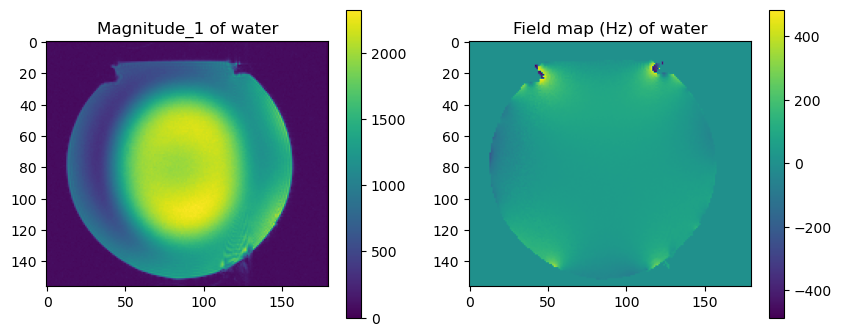

<Figure size 640x480 with 0 Axes>

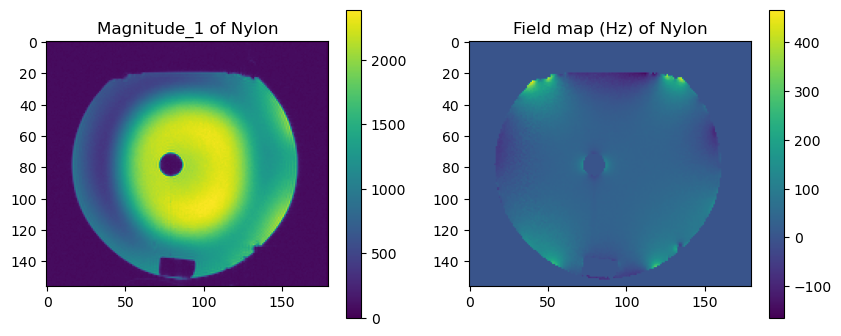

<Figure size 640x480 with 0 Axes>

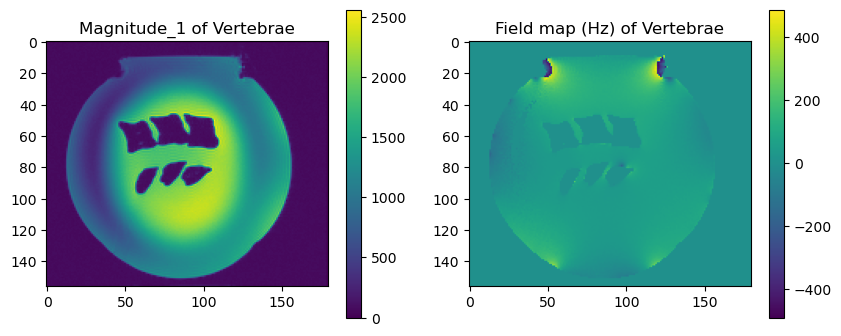

<Figure size 640x480 with 0 Axes>

In [7]:
# external solution = 700g sugar for 2L water + 80mL mouthwash + soap + salt
path_mag1_water = r"JOHANNA_BRUNNHILDE_20230322_144551_837000\FM_1_0MM_REFERENCE_0017\FM_1_0MM_REFERENCE_0017_fm_1.0mm_reference_20230322144552_17_e1.nii.gz"
path_phase_water = r"JOHANNA_BRUNNHILDE_20230322_144551_837000\FM_1_0MM_REFERENCE_0018\FM_1_0MM_REFERENCE_0018_fm_1.0mm_reference_20230322144552_18_e2_ph.nii.gz"
delta_B_water = rescale(path_mag1_water, path_phase_water, "water", delta_TE, masking=True, seuil=300)

#external solution + nylon
path_mag1_nylon = r"JOHANNA_BRUNNHILDE_20230322_144551_837000\FM_1_0MM_SPHERE_NYLON_0009\FM_1_0MM_SPHERE_NYLON_0009_fm_1.0mm_sphere_nylon_20230322144552_9_e1.nii.gz"
path_phase_nylon = r"JOHANNA_BRUNNHILDE_20230322_144551_837000\FM_1_0MM_SPHERE_NYLON_0010\FM_1_0MM_SPHERE_NYLON_0010_fm_1.0mm_sphere_nylon_20230322144552_10_e2_ph.nii.gz"
delta_B_nylon = rescale(path_mag1_nylon, path_phase_nylon, "Nylon", delta_TE, masking=True, seuil=350)

#external solution + vertebrae
path_mag1_vertebrae = r"JOHANNA_BRUNNHILDE_20230322_144551_837000\FM_1_0MM_VERTEBRAS_0013\FM_1_0MM_VERTEBRAS_0013_fm_1.0mm_vertebras_20230322144552_13_e1.nii.gz"
path_phase_vertebrae = r"JOHANNA_BRUNNHILDE_20230322_144551_837000\FM_1_0MM_VERTEBRAS_0014\FM_1_0MM_VERTEBRAS_0014_fm_1.0mm_vertebras_20230322144552_14_e2_ph.nii.gz"
delta_B_vertebrae = rescale(path_mag1_vertebrae, path_phase_vertebrae, "Vertebrae", delta_TE, masking=True, seuil=300)

In [8]:
##############################################################################""""""

x_nylon, y_nylon, z_nylon = 79,78,80
x_vertebrae, y_vertebrae, z_vertebrae = 79,74,78
dx, dy, dz = 12,12,12
dx_vertebrae, dy_vertebrae, dz_vertebrae = 40, 35, 35
# dx_vertebrae, dy_vertebrae, dz_vertebrae = 40, 40, 40

#################################################################################


(156, 180, 160)


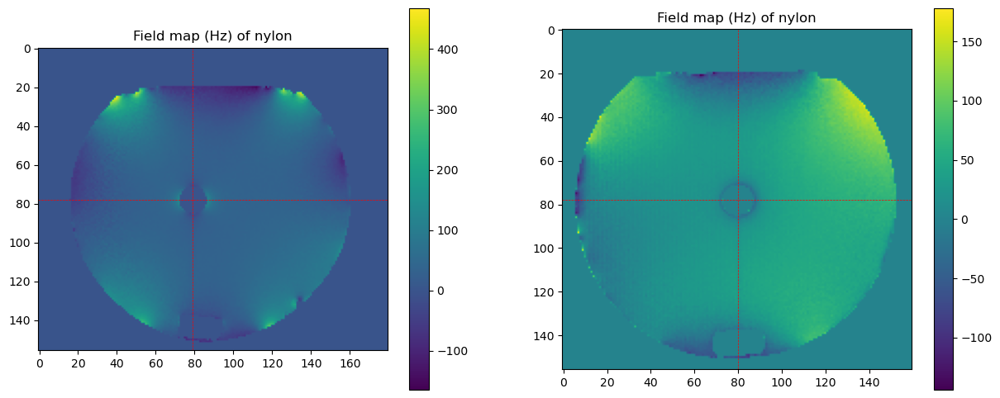

In [9]:
plt.figure(figsize=(15,6))

plt.subplot(1,2,1)
plt.imshow(delta_B_nylon[:,:,z_nylon])
plt.colorbar()
plt.axvline(x=x_nylon,color='r',linestyle='--', linewidth=0.5) #to find the center of the ball
plt.axhline(y=y_nylon,color='r',linestyle='--', linewidth=0.5) #to find the center of the ball
plt.title(f'Field map (Hz) of nylon')

plt.subplot(1,2,2)
plt.imshow(delta_B_nylon[:,x_nylon,:])
plt.colorbar()
plt.axvline(x=z_nylon,color='r',linestyle='--', linewidth=0.5) #to find the center of the ball
plt.axhline(y=y_nylon,color='r',linestyle='--', linewidth=0.5) #to find the center of the ball
plt.title(f'Field map (Hz) of nylon')

print(np.shape(delta_B_nylon))

(156, 180, 160)


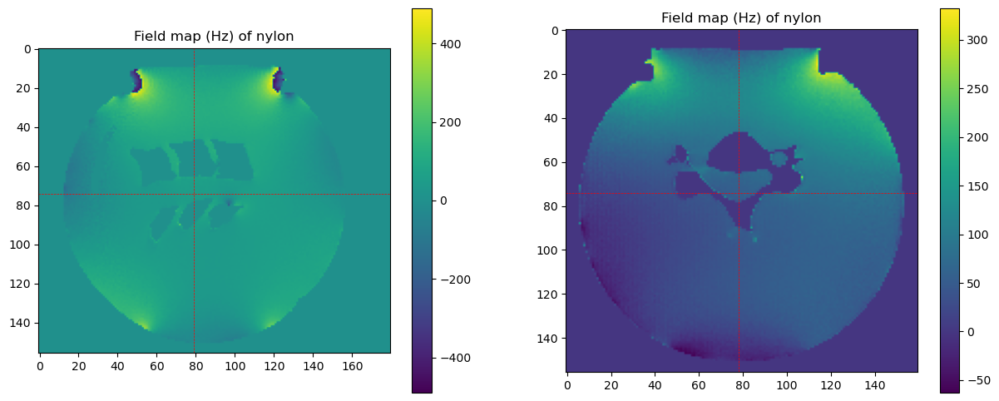

In [10]:
plt.figure(figsize=(15,6))

plt.subplot(1,2,1)
plt.imshow(delta_B_vertebrae[:,:,z_vertebrae])
plt.colorbar()
plt.axvline(x=x_vertebrae,color='r',linestyle='--', linewidth=0.5) #to find the center of the ball
plt.axhline(y=y_vertebrae,color='r',linestyle='--', linewidth=0.5) #to find the center of the ball
plt.title(f'Field map (Hz) of nylon')

plt.subplot(1,2,2)
plt.imshow(delta_B_vertebrae[:,x_vertebrae,:])
plt.colorbar()
plt.axvline(x=z_vertebrae,color='r',linestyle='--', linewidth=0.5) #to find the center of the ball
plt.axhline(y=y_vertebrae,color='r',linestyle='--', linewidth=0.5) #to find the center of the ball
plt.title(f'Field map (Hz) of nylon')

print(np.shape(delta_B_vertebrae))

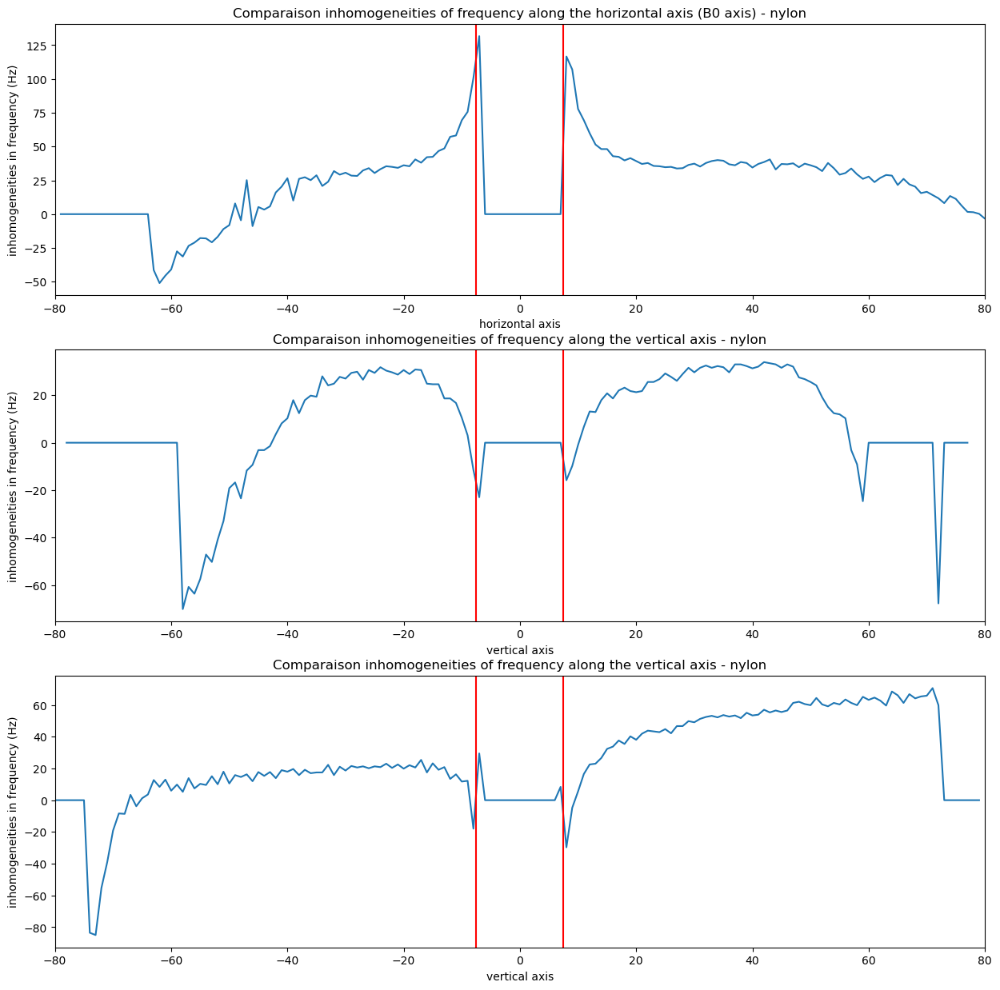

<Figure size 640x480 with 0 Axes>

In [11]:
##### plot lineplot axe horizontal
freq_nylon_x = (delta_B_nylon[y_nylon, :, z_nylon])

abscisse_nylon_x = [i-x_nylon for i in range(180)] #recenter the ball at zero

plt.figure(figsize=(15,15))
plt.subplot(3,1,1)
plt.plot(abscisse_nylon_x, freq_nylon_x)
plt.title('Comparaison inhomogeneities of frequency along the horizontal axis (B0 axis) - nylon')
plt.xlabel('horizontal axis')
plt.ylabel('inhomogeneities in frequency (Hz)')
plt.xlim(-80,80)
plt.axvline(x=7.5, c='r')
plt.axvline(x=-7.5, c='r')



##### plot lineplot axe vertical
freq_nylon_y = (delta_B_nylon[:, x_nylon, z_nylon])

abscisse_nylon_y = [i-y_nylon for i in range(np.shape(delta_B_nylon)[0])] #recenter the ball at zero


plt.subplot(3,1,2)
plt.plot(abscisse_nylon_y, freq_nylon_y, label='nylon')
plt.title('Comparaison inhomogeneities of frequency along the vertical axis - nylon')
plt.xlabel('vertical axis')
plt.ylabel('inhomogeneities in frequency (Hz)')
plt.xlim(-80,80)
plt.axvline(x=7.5, c='r')
plt.axvline(x=-7.5, c='r')


##### plot lineplot axe profondeur
freq_nylon_z = (delta_B_nylon[y_nylon, x_nylon, :])

abscisse_nylon_z = [i-z_nylon for i in range(np.shape(delta_B_nylon)[2])] #recenter the ball at zer

plt.subplot(3,1,3)
plt.plot(abscisse_nylon_z, freq_nylon_z, label='nylon')
plt.title('Comparaison inhomogeneities of frequency along the vertical axis - nylon')
plt.xlabel('vertical axis')
plt.ylabel('inhomogeneities in frequency (Hz)')
plt.axvline(x=7.5, c='r')
plt.axvline(x=-7.5, c='r')

plt.xlim(-80,80)

plt.show()
plt.tight_layout()

Correction: 

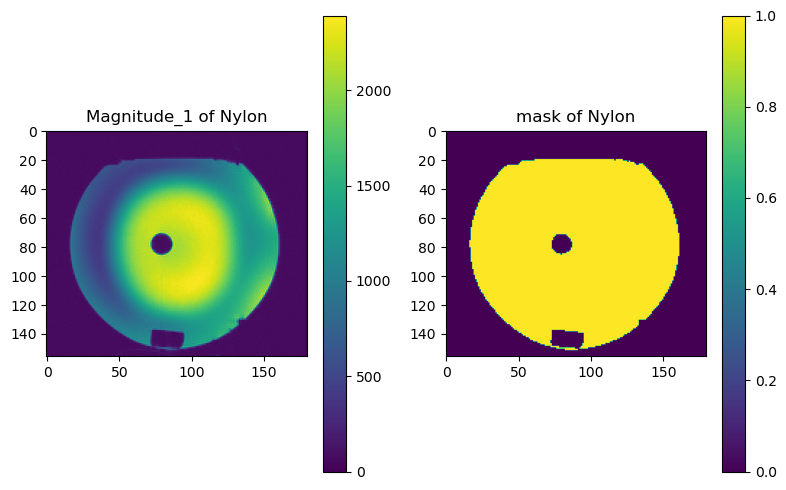

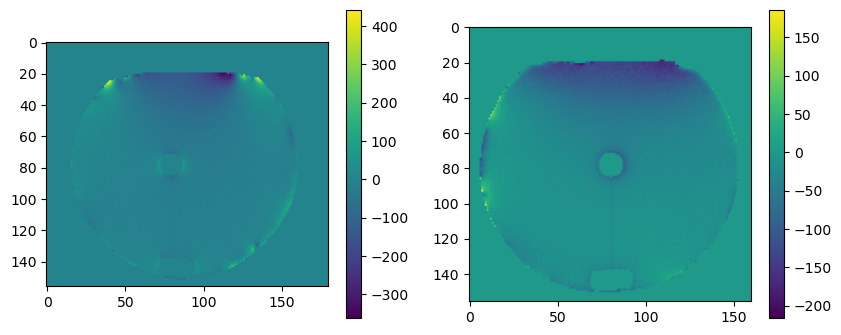

In [12]:
fm_nylon = (delta_B_nylon - gaussian_filter(delta_B_water, sigma=2))*mask(path_mag1_nylon, 'Nylon', tresh=300, plot=True, slice=z_nylon)
plt.figure(figsize=(10,4))
plt.subplot(121)
plt.imshow(fm_nylon[:,:,z_nylon])
plt.colorbar()
plt.subplot(122)
plt.imshow(fm_nylon[:,x_nylon,:])
plt.colorbar()

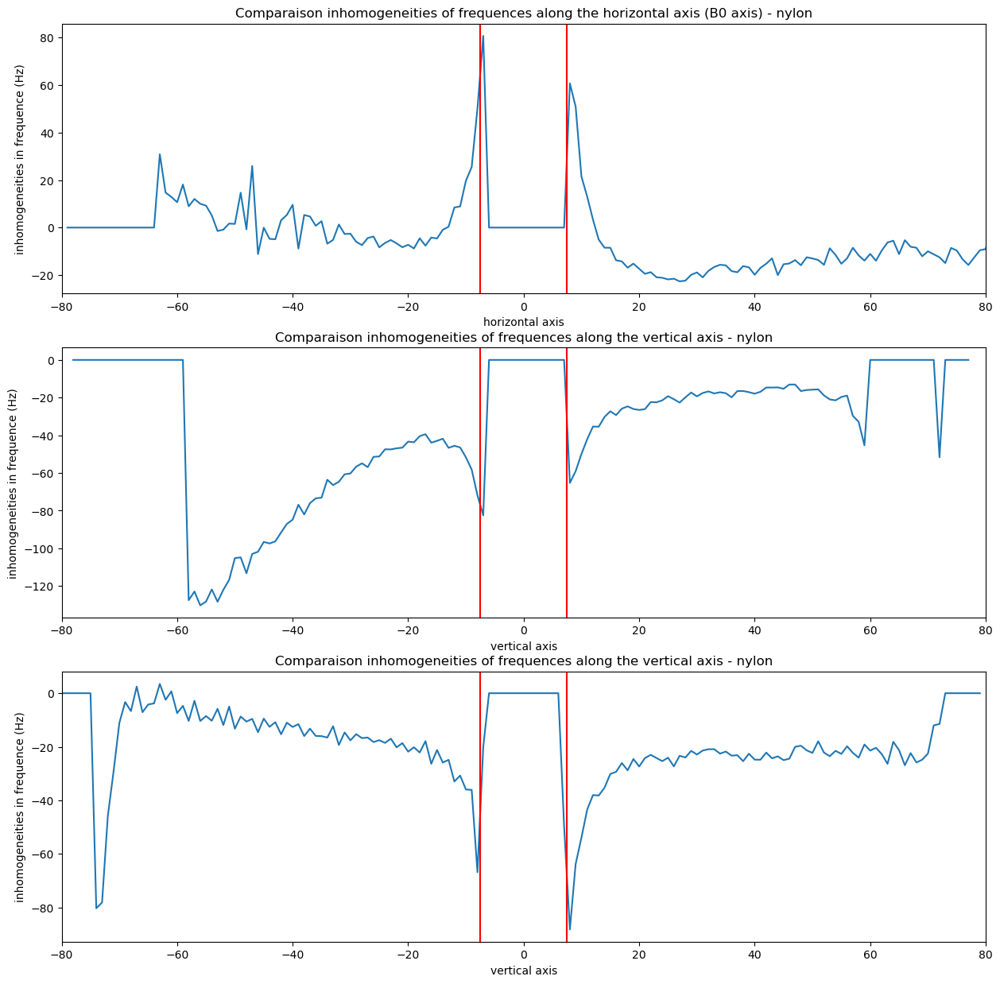

<Figure size 640x480 with 0 Axes>

In [13]:
##### plot lineplot axe horizontal
freq_nylon_x = (fm_nylon[y_nylon, :, z_nylon])

abscisse_nylon_x = [i-x_nylon for i in range(180)] #recenter the ball at zero

plt.figure(figsize=(15,15))
plt.subplot(3,1,1)
plt.plot(abscisse_nylon_x, freq_nylon_x)
plt.title('Comparaison inhomogeneities of frequences along the horizontal axis (B0 axis) - nylon')
plt.xlabel('horizontal axis')
plt.ylabel('inhomogeneities in frequence (Hz)')
plt.xlim(-80,80)
plt.axvline(x=7.5, c='r')
plt.axvline(x=-7.5, c='r')



##### plot lineplot axe vertical
freq_nylon_y = (fm_nylon[:, x_nylon, z_nylon])

abscisse_nylon_y = [i-y_nylon for i in range(np.shape(delta_B_nylon)[0])] #recenter the ball at zero


plt.subplot(3,1,2)
plt.plot(abscisse_nylon_y, freq_nylon_y, label='nylon')
plt.title('Comparaison inhomogeneities of frequences along the vertical axis - nylon')
plt.xlabel('vertical axis')
plt.ylabel('inhomogeneities in frequence (Hz)')
plt.xlim(-80,80)
plt.axvline(x=7.5, c='r')
plt.axvline(x=-7.5, c='r')


##### plot lineplot axe profondeur
freq_nylon_z = (fm_nylon[y_nylon, x_nylon, :])

abscisse_nylon_z = [i-z_nylon for i in range(np.shape(delta_B_nylon)[2])] #recenter the ball at zer

plt.subplot(3,1,3)
plt.plot(abscisse_nylon_z, freq_nylon_z, label='nylon')
plt.title('Comparaison inhomogeneities of frequences along the vertical axis - nylon')
plt.xlabel('vertical axis')
plt.ylabel('inhomogeneities in frequence (Hz)')
plt.axvline(x=7.5, c='r')
plt.axvline(x=-7.5, c='r')

plt.xlim(-80,80)

plt.show()
plt.tight_layout()

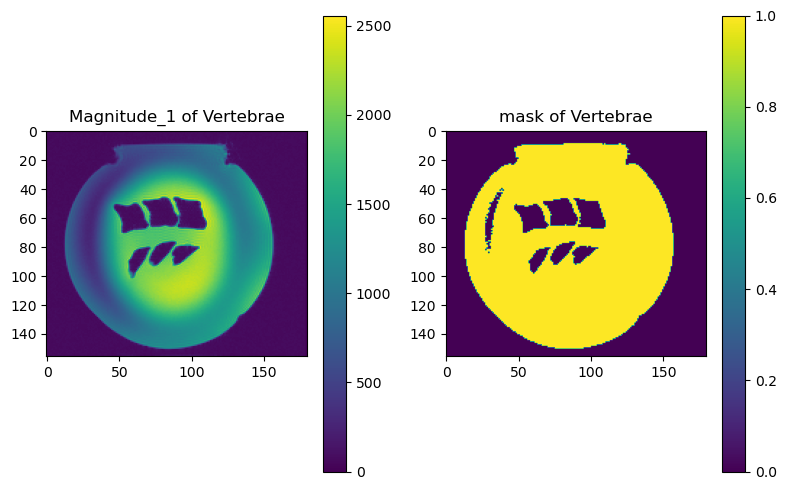

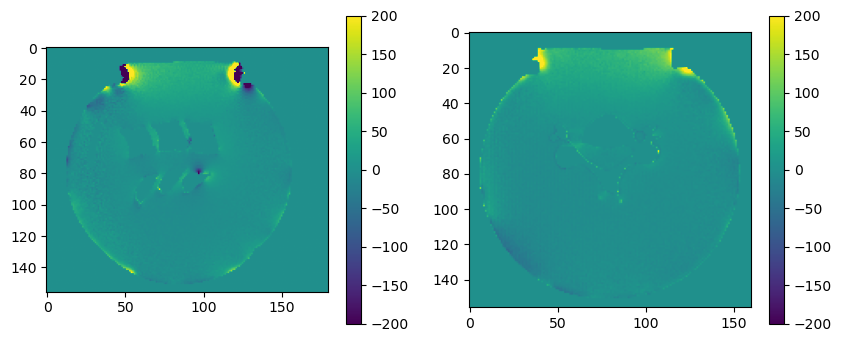

In [14]:
fm_vertebrae = (delta_B_vertebrae- gaussian_filter(delta_B_water, sigma=2))*mask(path_mag1_vertebrae, 'Vertebrae', tresh=300, plot=True, slice=z_vertebrae)
plt.figure(figsize=(10,4))
plt.subplot(121)
plt.imshow(fm_vertebrae[:,:,z_vertebrae], vmin=-200, vmax=200)
plt.colorbar()
plt.subplot(122)
plt.imshow(fm_vertebrae[:,x_vertebrae,:], vmin=-200, vmax=200)
plt.colorbar()

In [15]:
def rescaling_FOV(field_map, x, y, z, dx=dx, dy=dy, dz=dz):
    '''
    Reshape field_map to a smaller array

    Create a new smaller matrix of volume 2dx*2dy*2dz with values recentered on x,y,z
    Attention: x is the second component and y the first one.

    Parameters
    ----------
    field_map : numpy.ndarray
        3D array pf the FM to reshape.
    x : int
        x coordinate around which field_map will be reshaped
    y : int
        y coordinate around which field_map will be reshaped
    z : int
        z coordinate around which field_map will be reshaped
    dx : int, optional
        0.5*width along the x direction of the reshaped matrix. The default is dx.
    dy : int, optional
        0.5*width along the y direction of the reshaped matrix. The default is dy.
    dz : int, optional
        0.5*width along the z direction of the reshaped matrix. The default is dz.
            
    Returns
    -------
    rescaled_matrix : numpy.ndarray
        Reshaped 3D array.

    '''
    rescaled_matrix= field_map[y-dy:y+dy+1, x-dx:x+dx+1, z-dz: z+dz+1] 
   
    return rescaled_matrix

The average background of the fm of the smoothed nylon, backgound corrected, is -21.592454805080745


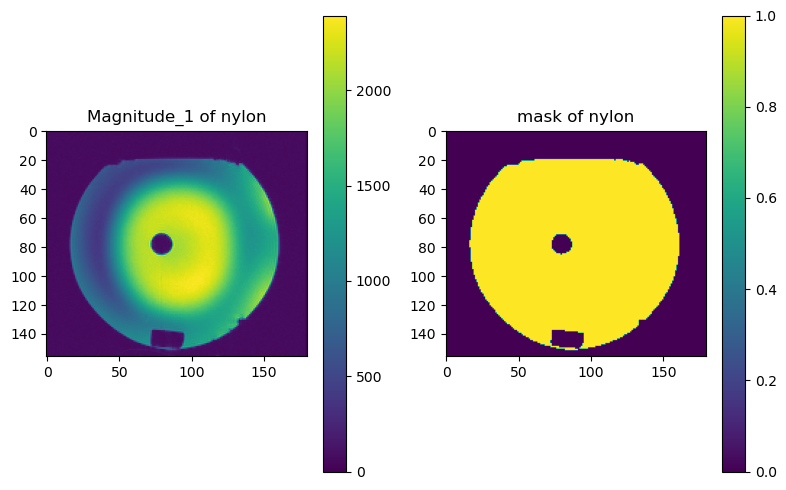

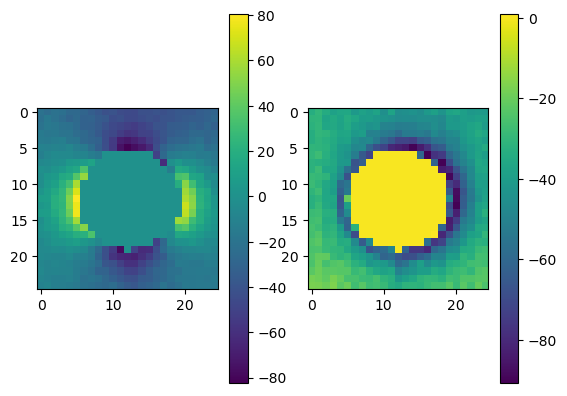

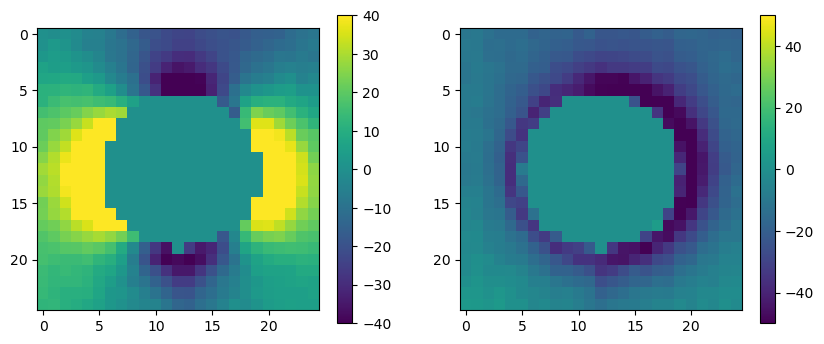

In [16]:
mask_nylon = rescaling_FOV(mask(path_mag1_nylon, 'nylon', tresh=300, plot=True, slice=z_nylon), x=x_nylon, y=y_nylon, z=z_nylon)




fm_exp_nylon_final_presque = rescaling_FOV(fm_nylon, x_nylon, y_nylon, z_nylon)
plt.figure()
plt.subplot(121)
plt.imshow(fm_exp_nylon_final_presque[:,:,dz])
plt.colorbar()
plt.subplot(122)
plt.imshow(fm_exp_nylon_final_presque[:,dx,:])
plt.colorbar()


##########################################################33
fm_exp_nylon_final_presque_presque  = gaussian_filter(fm_exp_nylon_final_presque, sigma=0.5) #smooth a bit the field map

avg_backg_nylon = np.average(fm_exp_nylon_final_presque_presque, weights = mask_nylon)
print(f'The average background of the fm of the smoothed nylon, backgound corrected, is {avg_backg_nylon}')
fm_exp_nylon_final = (fm_exp_nylon_final_presque_presque - avg_backg_nylon)*mask_nylon

####################################################3
plt.figure(figsize=(10,4))
plt.subplot(121)
plt.imshow(fm_exp_nylon_final[:,:,dz], vmin=-40, vmax=40)
plt.colorbar()
plt.subplot(122)
plt.imshow(fm_exp_nylon_final[:,dx,:], vmin=-50, vmax=50)
plt.colorbar()

The average background of the fm of the smoothed vertebrae, backgound corrected, is 0.3737770464139003


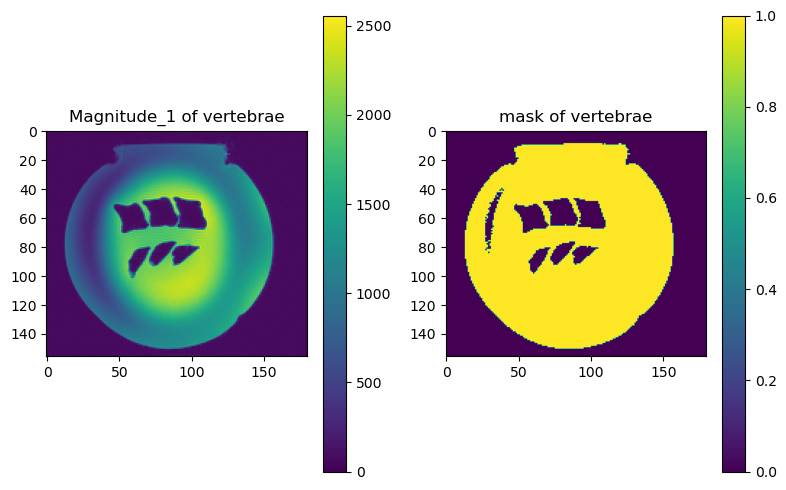

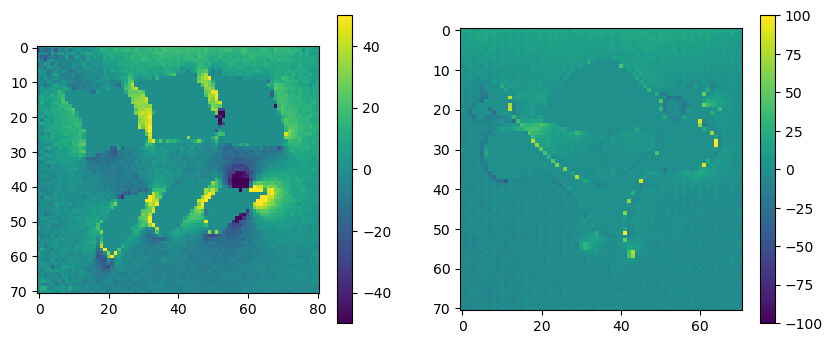

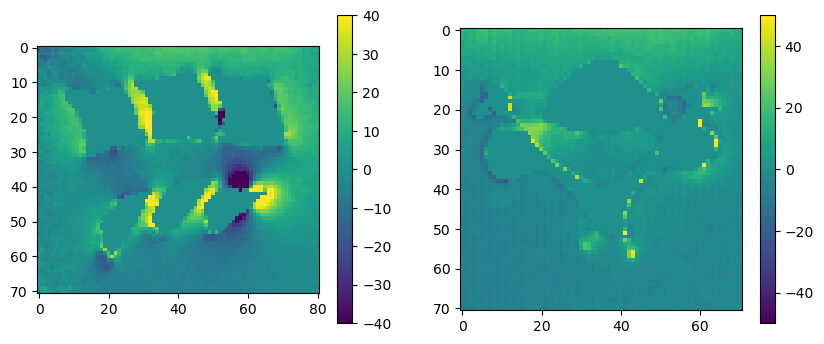

In [17]:
mask_vertebrae = rescaling_FOV(mask(path_mag1_vertebrae, 'vertebrae', tresh=300, plot=True, slice=z_vertebrae),  dx=dx_vertebrae, dy=dy_vertebrae, dz=dz_vertebrae, x=x_vertebrae, y=y_vertebrae, z=z_vertebrae)


fm_exp_vertebrae_final_presque = rescaling_FOV(fm_vertebrae, x_vertebrae, y_vertebrae, z_vertebrae, dx=dx_vertebrae, dy=dy_vertebrae, dz=dz_vertebrae)
plt.figure(figsize=(10,4))
plt.subplot(121)
plt.imshow(fm_exp_vertebrae_final_presque[:,:,dz_vertebrae], vmin=-50, vmax=50)
plt.colorbar()
plt.subplot(122)
plt.imshow(fm_exp_vertebrae_final_presque[:,dx_vertebrae,:], vmin=-100, vmax=100)
plt.colorbar()

##########################################################33
fm_exp_vertebrae_final_presque_presque  = gaussian_filter(fm_exp_vertebrae_final_presque, sigma=0.5) #smooth a bit the field map

avg_backg_vertebrae = np.average(fm_exp_vertebrae_final_presque_presque, weights = mask_vertebrae)
print(f'The average background of the fm of the smoothed vertebrae, backgound corrected, is {avg_backg_vertebrae}')
fm_exp_vertebrae_final = (fm_exp_vertebrae_final_presque_presque - avg_backg_vertebrae)*mask_vertebrae

####################################################3
plt.figure(figsize=(10,4))
plt.subplot(121)
plt.imshow(fm_exp_vertebrae_final[:,:,dz_vertebrae], vmin=-40, vmax=40)
plt.colorbar()
plt.subplot(122)
plt.imshow(fm_exp_vertebrae_final[:,dx_vertebrae,:], vmin=-50, vmax=50)
plt.colorbar()

There is quite a huge gradient in the vertebre acquisition so we can try to correct it with linear gradients

In [18]:
def calcul_gradient_3D(fm, mask, mode='normal'):
    """
    Calculate the gradients of a 3D image along the x, y, and z axes. 
    
    If mode='linear', calculate the linear gradients instead.

    Parameters
    ----------
    fm : numpy.ndarray
        3D array with want to compute the gradients of.
    mask : numpy.ndarray
        3D array mask of the FM.
    mode : str, optional
        mode of calculation. Can be 'normal' or 'linear'. The default is 'normal'
        
   Returns
    -------
    (y_grad, x_grad, z_grad) : tuple of numpy ndarrays
        The gradient along the y, x, and z axes.

    """
    
    m,n,p = np.shape(fm)
    X_abs = np.array([i for i in range(n)])
    Y_abs = np.array([i for i in range(m)])
    Z_abs = np.array([i for i in range(p)])

    
    # gradient z axis
    z_grad = []
    for i in range(p):
        s_avg = np.average(fm[:,:,i], weights=mask[:,:,i])
        z_grad.append(s_avg)
    
    # gradient x axis (horizontal)
    x_grad = []
    for i in range(n):
        s_avg = np.average(fm[:,i,:], weights=mask[:,i,:])
        x_grad.append(s_avg)

    # gradient y axis (vertical)
    y_grad = []
    for i in range(m):
        s_avg = np.average(fm[i,:,:], weights=mask[i,:,:])
        y_grad.append(s_avg)
 
    
    plt.figure()       
    plt.plot(Z_abs, z_grad, label='z_axis')
    plt.plot(X_abs, x_grad, label='horizontal')
    plt.plot(Y_abs, y_grad, label='vertical')
    
    
    
    if mode=='linear':
        res_z = scipy.stats.linregress(Z_abs, z_grad)
        res_x = scipy.stats.linregress(X_abs, x_grad)
        res_y = scipy.stats.linregress(Y_abs, y_grad)
        z_grad = res_z.intercept + res_z.slope*Z_abs
        x_grad=res_x.intercept + res_x.slope*X_abs
        y_grad = res_y.intercept + res_y.slope*Y_abs
        plt.plot(Z_abs, res_z.intercept + res_z.slope*Z_abs, label='z')
        plt.plot(X_abs, res_x.intercept + res_x.slope*X_abs, label='x')
        plt.plot(Y_abs, res_y.intercept + res_y.slope*Y_abs, label='y')
    plt.legend()

    return(y_grad, x_grad, z_grad)

def correct_grad3D(fm, mask, y_grad, x_grad, z_grad):
    """
    Correct for 3D gradient artifacts in a 3D image.
        
    Parameters
    ----------
    fm : numpy.ndarray
        3D array with want to correct.
    mask : numpy.ndarray
        3D array mask of the FM.
    y_grad : numpy.ndarray
        1D gradient along the y-axis
    x_grad : numpy.ndarray
        1D gradient along the x-axis
    z_grad : numpy.ndarray
        1D gradient along the z-axis
        
   Returns
    -------
    fm_exp_gradcorrected*mask : numpy ndarray
        3D array of the corrected FM
    """    
    
    # correction
    m,n,p=np.shape(fm)
    fm_exp_gradcorrected = np.zeros((m,n,p))
    for i in range(m):
        for j in range(n):
            for k in range(p):
                fm_exp_gradcorrected[i,j,k] = fm[i,j,k] - y_grad[i] -x_grad[j] - z_grad[k]
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)         
    plt.imshow(fm[:,:,40])
    plt.colorbar()
    plt.subplot(1,2,2)         
    plt.imshow((fm_exp_gradcorrected*mask)[:,:,40])
    plt.colorbar()
    
    avg_backg = np.average(fm_exp_gradcorrected, weights = mask)
    print(f'The average background of the linearly corrected fm, backgound corrected, is {avg_backg}')
    fm_exp_gradcorrected = (fm_exp_gradcorrected - avg_backg)*mask
    return fm_exp_gradcorrected


The average background of the linearly corrected fm, backgound corrected, is -0.05859719329341261


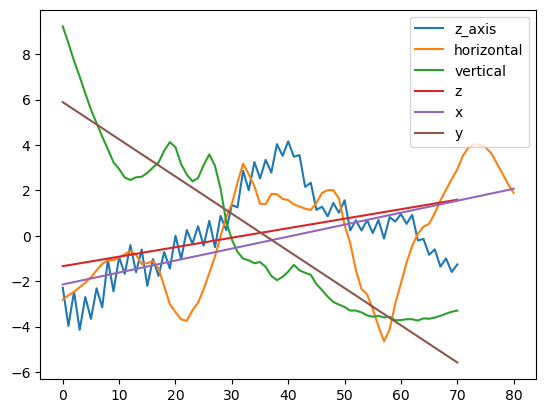

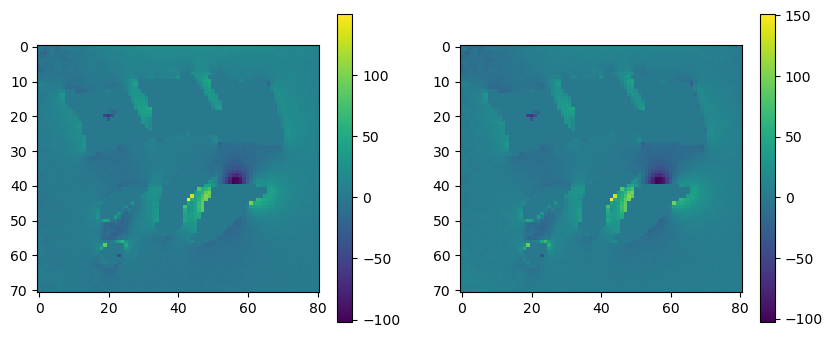

In [19]:
y_grad, x_grad, z_grad= calcul_gradient_3D(fm_exp_vertebrae_final, mask_vertebrae, mode='linear')
fm_exp_vertebrae_final_linearcorrection = correct_grad3D(fm_exp_vertebrae_final ,mask_vertebrae, y_grad, x_grad, z_grad)

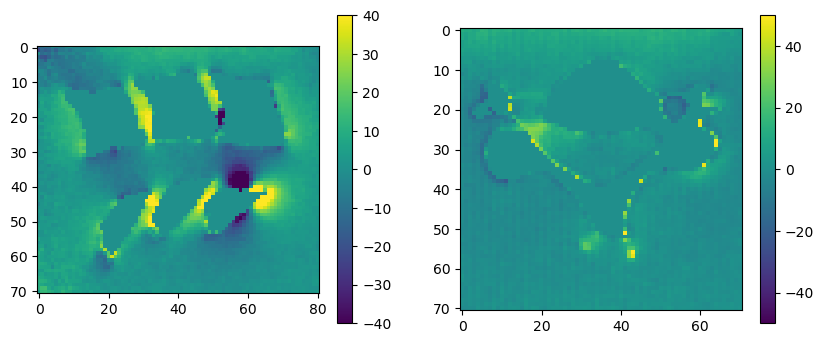

In [20]:
plt.figure(figsize=(10,4))
plt.subplot(121)
plt.imshow(fm_exp_vertebrae_final_linearcorrection[:,:,dz_vertebrae], vmin=-40, vmax=40)
plt.colorbar()
plt.subplot(122)
plt.imshow(fm_exp_vertebrae_final_linearcorrection[:,dx_vertebrae,:], vmin=-50, vmax=50)
plt.colorbar()

### B. Simulations

Export the masks:

(25, 25, 25)


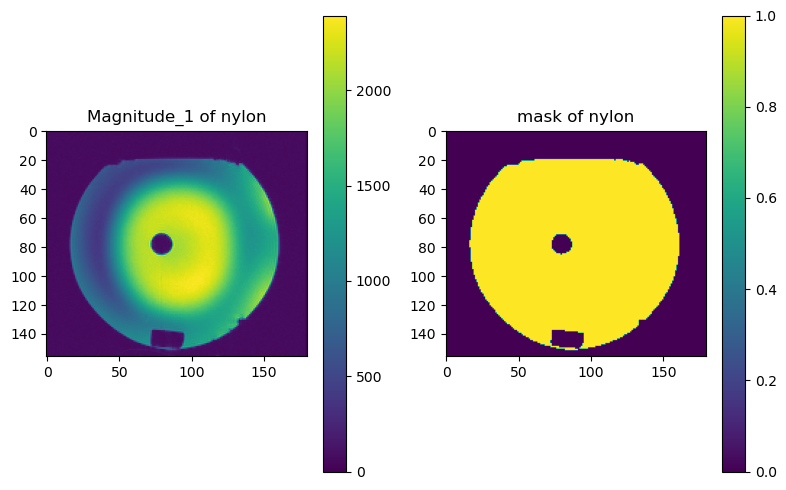

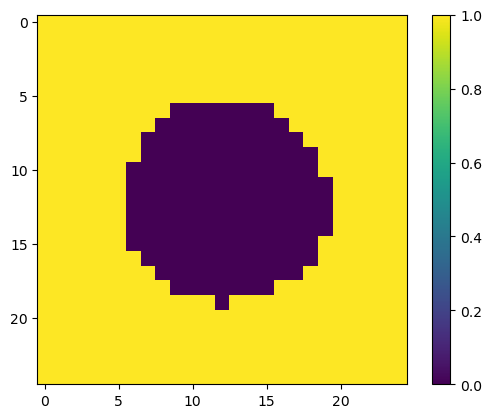

In [21]:
mask_nylon = rescaling_FOV(mask(path_mag1_nylon, 'nylon', tresh=300, plot=True, slice=z_nylon), x=x_nylon, y=y_nylon, z=z_nylon)
plt.figure()
plt.imshow(mask_nylon[:,:,dz])
plt.colorbar()

print(np.shape(mask_nylon))

### save and export the masks in matlab format to run the simulation on them
mdic = {"mask_nylon": mask_nylon, "label": "mask_nylon"}
# savemat("mask_nylon.mat", mdic)

(71, 81, 71)


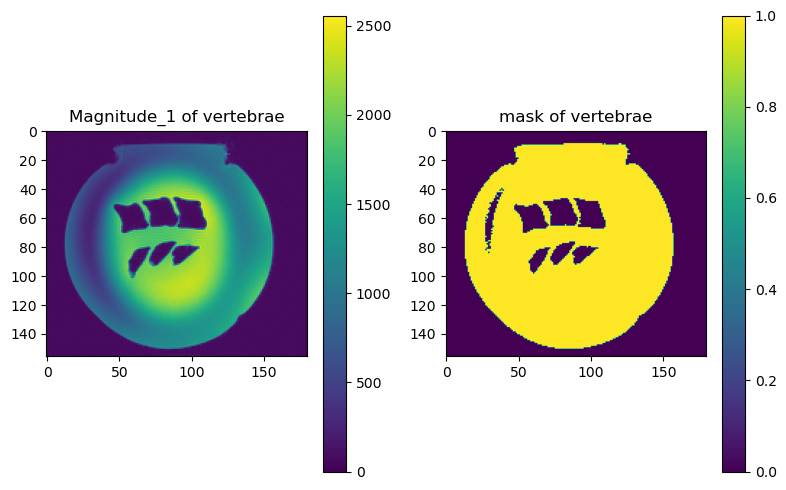

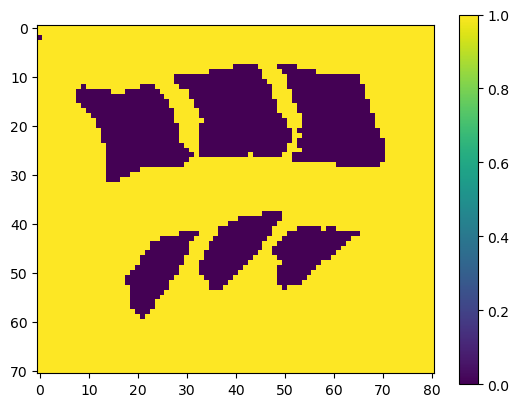

In [22]:
mask_vertebrae = rescaling_FOV(mask(path_mag1_vertebrae, 'vertebrae', tresh=300, plot=True, slice=z_vertebrae),  dx=dx_vertebrae, dy=dy_vertebrae, dz=dz_vertebrae, x=x_vertebrae, y=y_vertebrae, z=z_vertebrae)
plt.figure()
plt.imshow(mask_vertebrae[:,:,dz_vertebrae])
plt.colorbar()

print(np.shape(mask_vertebrae))

### save and export the masks in matlab format to run the simulation on them
mdic = {"mask_vertebrae": mask_vertebrae, "label": "mask_vertebrae"}
# savemat("mask_vertebrae.mat", mdic)

Import the simu:

In [23]:
simu_mask_nylon_final = -(scipy.io.loadmat(r"I_mask_nylon_simu.mat")['I'][137:162,137:162,137:162]-1)
simu_nylon_final = scipy.io.loadmat(r"i_sus_simu_nylon.mat")['I_sus'][137:162,137:162,137:162].real * simu_mask_nylon_final

print(np.shape(simu_nylon_final))
print(np.shape(simu_mask_nylon_final))



(25, 25, 25)
(25, 25, 25)


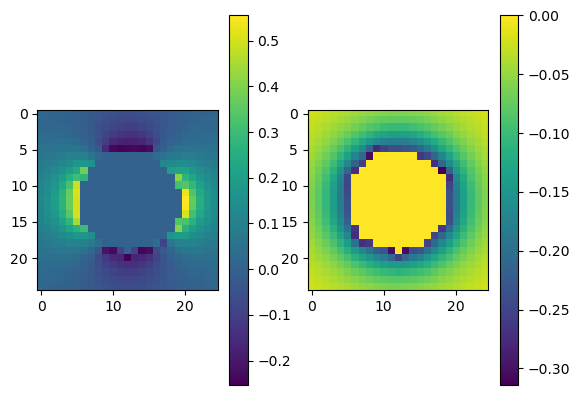

In [24]:
plt.figure()
plt.subplot(121)
plt.imshow(simu_nylon_final[:,:,dz])
plt.colorbar()
plt.subplot(122)
plt.imshow(simu_nylon_final[:,dx,:])
plt.colorbar()

In [25]:
simu_mask_vertebrae_final = -(scipy.io.loadmat(r"I_mask_vertebrae_simu.mat")['I'][114:185,109:190,114:185]-1)
simu_vertebrae_final = scipy.io.loadmat(r"i_sus_simu_vertebrae.mat")['I_sus'][114:185,109:190,114:185].real * simu_mask_vertebrae_final

print(np.shape(simu_vertebrae_final))
print(np.shape(simu_mask_vertebrae_final))

(71, 81, 71)
(71, 81, 71)


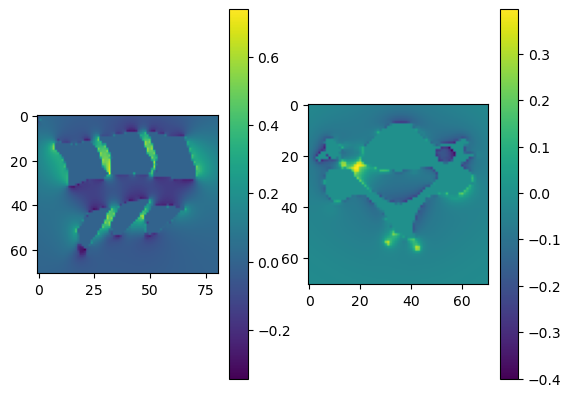

In [26]:
plt.figure()
plt.subplot(121)
plt.imshow(simu_vertebrae_final[:,:,dz_vertebrae])
plt.colorbar()
plt.subplot(122)
plt.imshow(simu_vertebrae_final[:,dx_vertebrae,:])
plt.colorbar()

Check the superposition

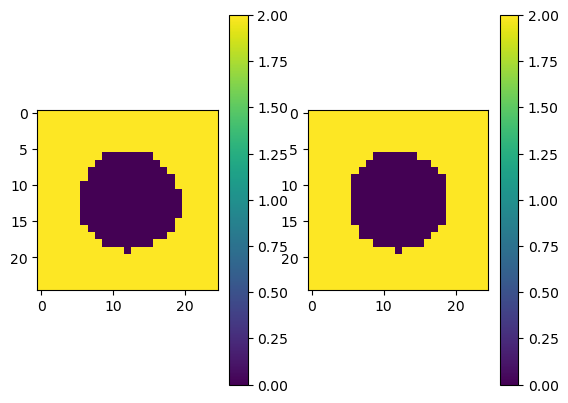

In [27]:
plt.figure()
plt.subplot(121)
plt.imshow((mask_nylon+simu_mask_nylon_final)[:,:,dz])
plt.colorbar()
plt.subplot(122)
plt.imshow((mask_nylon+simu_mask_nylon_final)[:,dx,:])
plt.colorbar()

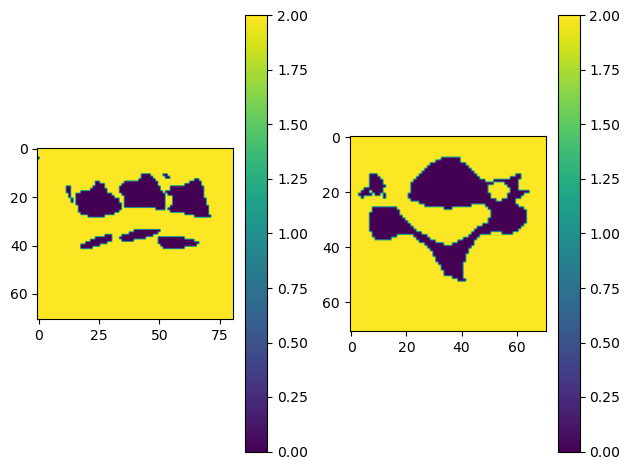

In [28]:
plt.figure()
plt.subplot(121)
plt.imshow(((mask_vertebrae+simu_mask_vertebrae_final))[:,:,dz_vertebrae+10])
plt.colorbar()
plt.subplot(122)
plt.imshow((mask_vertebrae+simu_mask_vertebrae_final)[:,dx_vertebrae,:])
plt.colorbar()
plt.tight_layout()

In [29]:
def linear_reg_simexp(fm_simu1, fm_exp1, mask_simu1, mask_exp1, part, xmin=0, ymin=0, zmin=0, xmax=np.shape(simu_nylon_final)[1], ymax=np.shape(simu_nylon_final)[0], zmax=np.shape(simu_nylon_final)[2], vmin=-30, vmax=30):
    '''
    Calculate the linear regression between `fm_simu1` and `fm_exp1`, excluding the values inside the masks (inside the compound).

    
    The regression between fm_simu1 and fm_exp1 is calculated on the voxels which coordinates are inside [xmin,xmax],[ymin,ymax],[zmin,zmax]
    Attention: x is the second component and y the first one.
    Plot the linear regression, one slice of the simulated and acquired field map and the histogram of the error. 
    
    Parameters
    ----------
    fm_simu1 : np.ndarray
        3D array of the simulated FM.
    fm_exp1 : np.ndarray
        3D array of the acquired FM.
    mask_simu1 : np.ndarray
        3D array of the simulated mask.
    mask_exp1 : np.ndarray
        3D array of the acquired mask.
    part : str
        description of the compound.
    xmin : int, optional
        the minimum x value to use for the regression calculation. The default is 0.
    ymin : int, optional
        the minimum y value to use for the regression calculation. The default is 0.
    zmin : int, optional
        the minimum z value to use for the regression calculation. The default is 0.
    xmax : int, optional
        the maximum x value to use for the regression calculation. The default is np.shape(simu_nylon_final)[1].
    ymax : int, optional
        the maximum y value to use for the regression calculation. The default is nnp.shape(simu_nylon_final)[0].
    zmax : int, optional
        the maximum z value to use for the regression calculation. The default is np.shape(simu_nylon_final)[2].
    vmin : int, optional
        Lower limit of the color scale. The default is -30.
    vmax : int, optional
        Higher limit of the color scale. The default is +30.

    Returns
    -------
    result_corrected : scipy.stats._stats_mstats_common.LinregressResult
        A tuple containing the parameters of the regression line.

    '''
  
    ### reshaping to 1D vector
    
    fm_simu=fm_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
    fm_exp=fm_exp1[ymin:ymax, xmin:xmax, zmin:zmax]
    mask_simu2=mask_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
    mask_exp2=mask_exp1[ymin:ymax, xmin:xmax, zmin:zmax]

    m,n,p = fm_simu.shape
    simu = fm_simu.reshape(m*n*p) #need to have vector 1D to apply the linear regression
    exp = fm_exp.reshape(n*m*p)

    mask_exp = mask_exp2.reshape(m*n*p)
    mask_simu = mask_simu2.reshape(m*n*p)

    exp_corrected = []
    simu_corrected=[]

    for i in range(m*p*n):
        if mask_exp[i]!=0 and mask_simu[i]!=0:
            simu_corrected.append(simu[i])
            exp_corrected.append(exp[i])

    ### regression lineaire
    result_corrected = scipy.stats.linregress(simu_corrected, exp_corrected)
    print(f'######## regression linéaire - {part} ############')
    print(f' fm_exp = {result_corrected.slope} * fm_simu + {result_corrected.intercept} ')
    print(f'R^2 = {result_corrected.rvalue **2}')
    print(f'p-value = {result_corrected.pvalue }')


    #######################"" plot################################
    plt.figure(figsize=(10,4))
    plt.subplot(121)
    plt.plot(simu_corrected, exp_corrected, '.', c='pink', label=part)
    plt.xlabel('Simulation')
    plt.ylabel('Experience')
    plt.title(f'Correlation between simulation and experience on {part}')
    plt.plot(simu, result_corrected.intercept + result_corrected.slope*simu, 'b')
#     plt.legend()
    
    plt.subplot(122) #histogram of the error
    approx = np.array([result_corrected.intercept + result_corrected.slope*simu_corrected[i] for i in range(len(simu_corrected))])
    error = exp_corrected - approx #f(xi)-y
    plt.hist(error, bins=75)
    plt.title('Histogram of the error f(xi)-y')
    plt.tight_layout()
    plt.show()
    
    plt.figure()
    plt.subplot(2,2,1)
    plt.imshow(result_corrected.slope*fm_simu[:,int((xmax-xmin)/2), :], vmin=vmin, vmax=vmax)
    plt.title("simu corrected")
    plt.colorbar()
    plt.subplot(2,2,2)
    plt.imshow(result_corrected.slope*fm_simu[:,:, int((zmax-zmin)/2)],  vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.subplot(2,2,3)
    plt.title("measurements")
    plt.colorbar()
    plt.imshow(fm_exp[:,int((xmax-xmin)/2), :],  vmin=vmin, vmax=vmax)
    plt.subplot(2,2,4)
    plt.imshow(fm_exp[:,:, int((zmax-zmin)/2)],  vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.tight_layout()
    plt.show()

    
    print(np.shape(fm_simu))
    return result_corrected

######## regression linéaire - whole array nylon ############
 fm_exp = 183.40309811654848 * fm_simu + 0.09893844069621188 
R^2 = 0.7943894536188431
p-value = 0.0


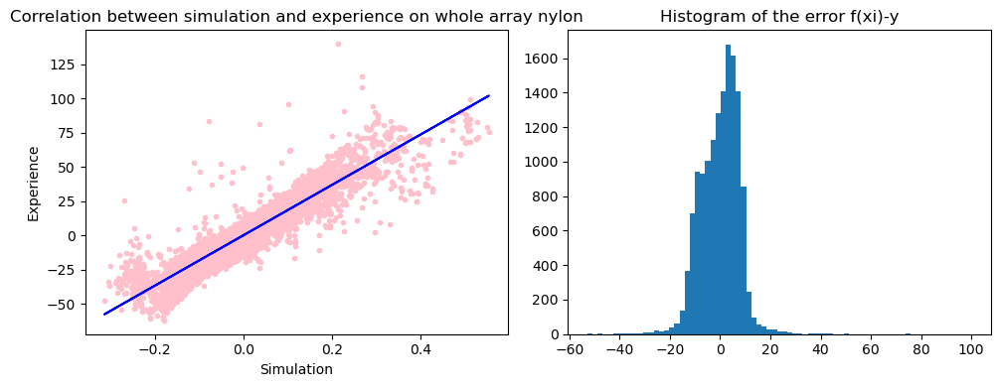

C:\Users\b\AppData\Local\Temp\ipykernel_25576\1071298440.py:104: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  plt.colorbar()


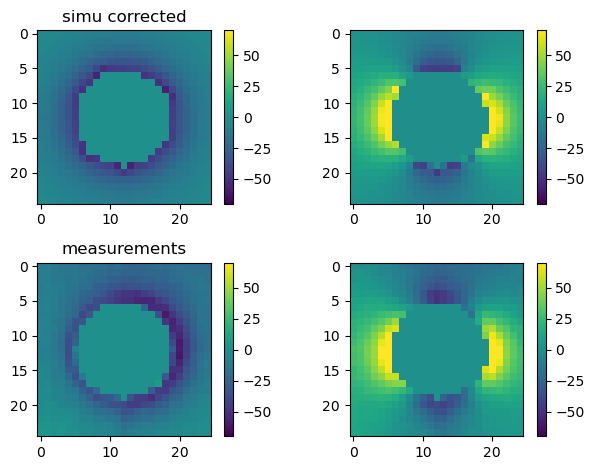

(25, 25, 25)


In [30]:
result_nylon = linear_reg_simexp(fm_simu1=simu_nylon_final, fm_exp1=fm_exp_nylon_final, mask_simu1=simu_mask_nylon_final, mask_exp1=mask_nylon, part="whole array nylon", xmin=0, ymin=0, zmin=0, xmax=np.shape(fm_exp_nylon_final)[1], ymax=np.shape(fm_exp_nylon_final)[0], zmax=np.shape(fm_exp_nylon_final)[2], vmin=-70, vmax=70)


######## regression linéaire - whole array vertebrae ############
 fm_exp = 53.862066056961616 * fm_simu + 0.408942285919517 
R^2 = 0.27511347409198206
p-value = 0.0


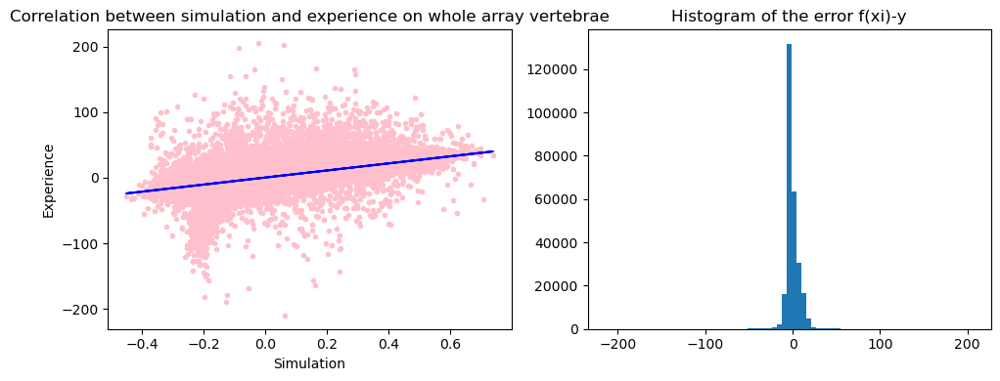

C:\Users\b\AppData\Local\Temp\ipykernel_25576\1071298440.py:104: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  plt.colorbar()


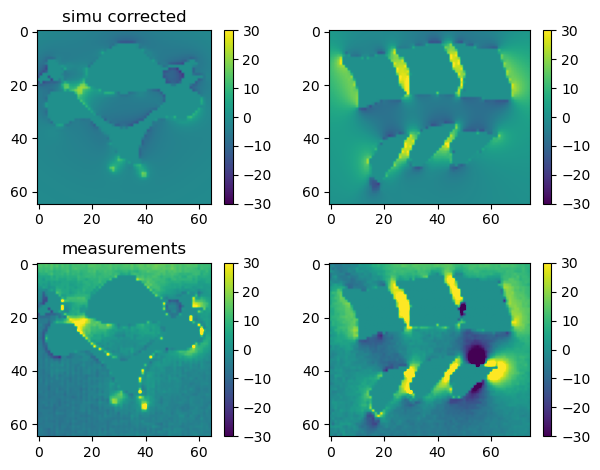

(65, 75, 65)


In [31]:
result_vertebrae = linear_reg_simexp(fm_simu1=simu_vertebrae_final, fm_exp1=fm_exp_vertebrae_final, mask_simu1=simu_mask_vertebrae_final, mask_exp1=mask_vertebrae, part="whole array vertebrae", xmin=3, ymin=3, zmin=3, xmax=np.shape(fm_exp_vertebrae_final)[1]-3, ymax=np.shape(fm_exp_vertebrae_final)[0]-3, zmax=np.shape(fm_exp_vertebrae_final)[2]-3, vmin=-30, vmax=30)


######## regression linéaire - intervertebral space vertebrae ############
 fm_exp = 71.6832681738599 * fm_simu + 1.4208243110257393 
R^2 = 0.37786739508135225
p-value = 0.0


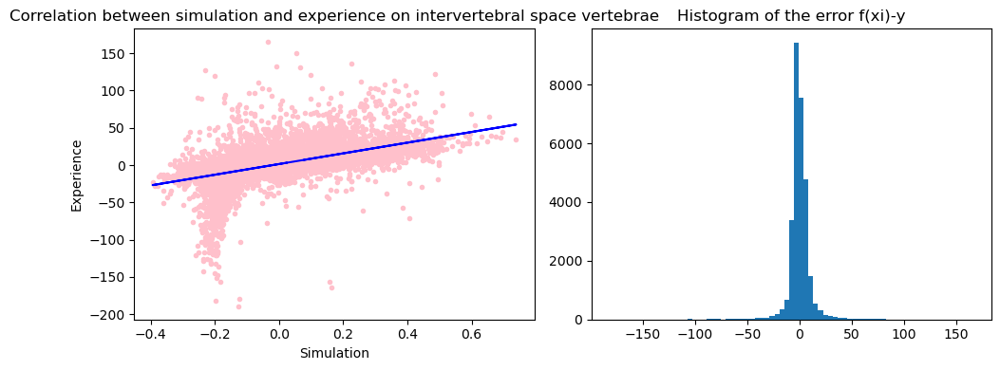

C:\Users\b\AppData\Local\Temp\ipykernel_25576\1071298440.py:104: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  plt.colorbar()


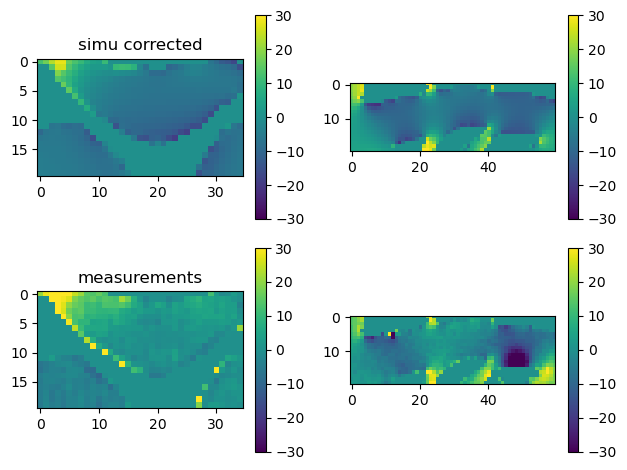

(20, 60, 35)


In [32]:
result_vertebrae_intervert = linear_reg_simexp(fm_simu1=simu_vertebrae_final, fm_exp1=fm_exp_vertebrae_final, mask_simu1=simu_mask_vertebrae_final, mask_exp1=mask_vertebrae, part="intervertebral space vertebrae", xmin=10, ymin=25, zmin=15, xmax=70, ymax=45, zmax=50)


######## regression linéaire - whole array vertebrae ############
 fm_exp = 52.750978560569905 * fm_simu + 0.45876686298394 
R^2 = 0.30919697916670263
p-value = 0.0


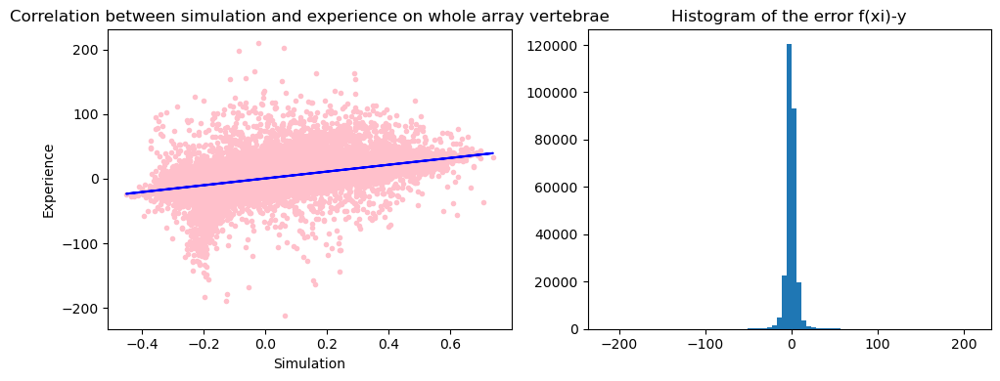

C:\Users\b\AppData\Local\Temp\ipykernel_25576\1071298440.py:104: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  plt.colorbar()


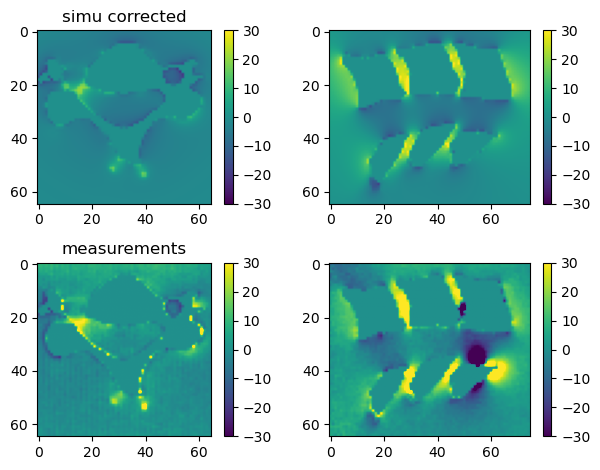

(65, 75, 65)


In [33]:
result_vertebrae_linearcorrect = linear_reg_simexp(fm_simu1=simu_vertebrae_final, fm_exp1=fm_exp_vertebrae_final_linearcorrection, mask_simu1=simu_mask_vertebrae_final, mask_exp1=mask_vertebrae, part="whole array vertebrae", xmin=3, ymin=3, zmin=3, xmax=np.shape(fm_exp_vertebrae_final)[1]-3, ymax=np.shape(fm_exp_vertebrae_final)[0]-3, zmax=np.shape(fm_exp_vertebrae_final)[2]-3, vmin=-30, vmax=30)


######## regression linéaire - intervertebral space vertebrae ############
 fm_exp = 73.89597545406491 * fm_simu + 1.5715613470238927 
R^2 = 0.39404389689592906
p-value = 0.0


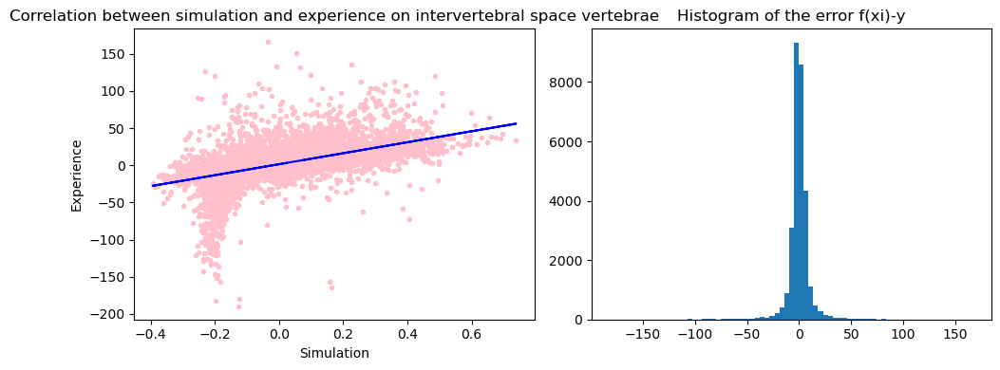

C:\Users\b\AppData\Local\Temp\ipykernel_25576\1071298440.py:104: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  plt.colorbar()


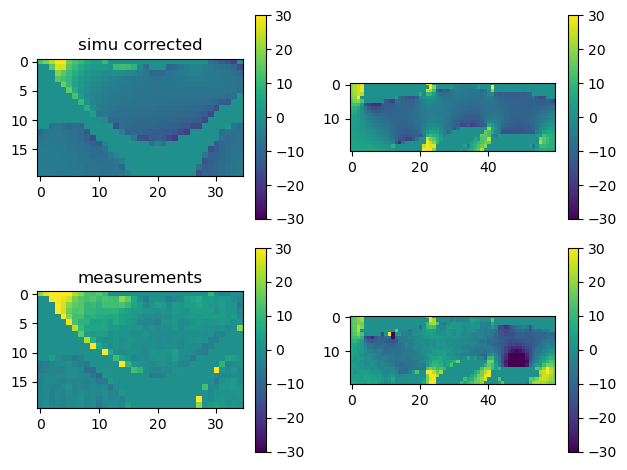

(20, 60, 35)


In [34]:
result_vertebrae_intervert_linearcorrect = linear_reg_simexp(fm_simu1=simu_vertebrae_final, fm_exp1=fm_exp_vertebrae_final_linearcorrection, mask_simu1=simu_mask_vertebrae_final, mask_exp1=mask_vertebrae, part="intervertebral space vertebrae", xmin=10, ymin=25, zmin=15, xmax=70, ymax=45, zmax=50)


### Linear regression cleaner for exportation


This is the same prinicple that above, but with a better format for exportation to the thesis

In [35]:
def linear_reg_simexp_clean(fm_simu1, fm_exp1, mask_simu1, mask_exp1, part, xmin, ymin, zmin, xmax, ymax, zmax):
    '''
    Calculate the linear regression between `fm_simu1` and `fm_exp1`, excluding the values inside the masks (inside the compound).

    
    The regression between fm_simu1 and fm_exp1 is calculated on the voxels which coordinates are inside [xmin,xmax],[ymin,ymax],[zmin,zmax]
    Attention: x is the second component and y the first one.
    Plot the linear regression, one slice of the simulated and acquired field map and the histogram of the error. 
    Better format for exportation 
    
    Parameters
    ----------
    fm_simu1 : np.ndarray
        3D array of the simulated FM.
    fm_exp1 : np.ndarray
        3D array of the acquired FM.
    mask_simu1 : np.ndarray
        3D array of the simulated mask.
    mask_exp1 : np.ndarray
        3D array of the acquired mask.
    part : str
        description of the compound.
    xmin : int
        the minimum x value to use for the regression calculation.
    ymin : int
        the minimum y value to use for the regression calculation.
    zmin : int
        the minimum z value to use for the regression calculation. 
    xmax : int
        the maximum x value to use for the regression calculation. 
    ymax : int
        the maximum y value to use for the regression calculation.
    zmax : int
        the maximum z value to use for the regression calculation.
    

    Returns
    -------
    result_corrected : scipy.stats._stats_mstats_common.LinregressResult
        A tuple containing the parameters of the regression line.

    '''
    ### reshaping to 1D vector
    
    fm_simu=fm_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
    fm_exp=fm_exp1[ymin:ymax, xmin:xmax, zmin:zmax]
    mask_simu2=mask_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
    mask_exp2=mask_exp1[ymin:ymax, xmin:xmax, zmin:zmax]

    m,n,p = fm_simu.shape
    simu = fm_simu.reshape(m*n*p) #need to have vector 1D to apply the linear regression
    exp = fm_exp.reshape(n*m*p)

    mask_exp = mask_exp2.reshape(m*n*p)
    mask_simu = mask_simu2.reshape(m*n*p)

    exp_corrected = []
    simu_corrected=[]

    for i in range(m*p*n):
        if mask_exp[i]!=0 and mask_simu[i]!=0:
            simu_corrected.append(simu[i])
            exp_corrected.append(exp[i])

    ### regression lineaire
    result_corrected = scipy.stats.linregress(simu_corrected, exp_corrected)
    print(f'######## regression linéaire - {part} ############')
    print(f' fm_exp = {result_corrected.slope} * fm_simu + {result_corrected.intercept} ')
    print(f'R^2 = {result_corrected.rvalue **2}')
    print(f'p-value = {result_corrected.pvalue }')


    #######################"" plot################################
    plt.figure()
    plt.plot(simu_corrected[::], exp_corrected[::], '.', c='pink', label=part)
    plt.plot(simu, result_corrected.intercept + result_corrected.slope*simu, 'black')
    print(plt.xlim())
    print(plt.ylim())
    plt.axis('off')
#     plt.savefig(r"figures\correlation_simu_exp_second_vertebral_phantom_test6_reg.png")
    
    plt.figure(figsize=(9,7))
    plt.subplot(221)
    plt.plot(simu_corrected[::4], exp_corrected[::4], '.', c='pink', label=part)
    plt.xlabel('Simulated data (ppm)', size=12)
    plt.ylabel('Measured data (Hz)', size=12)
#     plt.title(f'Correlation acquisition/simulation')
    plt.plot(simu, result_corrected.intercept + result_corrected.slope*simu, 'black')
#     plt.legend()
    
    plt.subplot(223) ## histogram of the error
    approx = np.array([result_corrected.intercept + result_corrected.slope*simu_corrected[i] for i in range(len(simu_corrected))])
    error = exp_corrected - approx #f(xi)-y
    plt.hist(error, bins=75)
    plt.xlabel('$ f(x_i)-y$', size=13)
    plt.ylabel('Number of voxels', size=13)

#     plt.title('Histogram of the error f(xi)-y')
    
    plt.subplot(222)
    slice = int((zmax-zmin)/2)
    slice = 40
    A=fm_simu1[:, :, slice].copy()
    A[ymin,xmin:xmax+1] = 1
    A[ymax,xmin:xmax+1] = 1
    A[ymin:ymax,xmin] = 1
    A[ymin:ymax,xmax] = 1
#     fm_simu=fm_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
#     plt.imshow(np.transpose(fm_simu[:,::-1,slice]))
    plt.imshow(A[:,::-1].T)
#     plt.title('Simulation (ppm)', size=12)
#     plt.colorbar()
    plt.axis('off')

    plt.subplot(224)
    slice=40
    B=fm_simu1[:, slice, :].copy()
    B[ymin,zmin:zmax+1] = 1
    B[ymax,zmin:zmax+1] = 1
    B[ymin:ymax,zmin] = 1
    B[ymin:ymax,zmax] = 1
    plt.imshow(B, vmax=0.3)
#     plt.imshow(fm_simu[:,int((xmax-xmin)/2), :])    
#     plt.colorbar()
#     plt.title(f'Measurement (Hz)', size=12)
    plt.axis('off')

    plt.tight_layout()
    
#     plt.text(x= -38.45 ,y=-26.4, s='a)', size=15)
#     plt.text(x= -0.8 ,y=-26.4, s='b)', size=15)
#     plt.text(x= -38.45 ,y=-1, s='c)', size=15)
#     plt.text(x= -0.8,y=-1, s='d)', size=15)
#     plt.text(x= -19,y=-20, s='$y = -115.6 \cdot x-8.88$', size=12)
#     tikzplotlib.save(r"figures\correlation_simu_exp_second_vertebral_phantom_4figs.tex")
#     plt.savefig(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\tests materiaux\230224_test5_sugar_mouthwash\figures\linearregression_sugar_c1.png", dpi=300)

    plt.show()

    

    
    print(np.shape(fm_simu))
    return result_corrected

######## regression linéaire - intervertebral space vertebrae ############
 fm_exp = 68.54130215463138 * fm_simu + 1.0407373382924512 
R^2 = 0.403930669239386
p-value = 0.0
(-0.4704763889312744, 0.796216607093811)
(-207.42458070400104, 183.86129806682544)


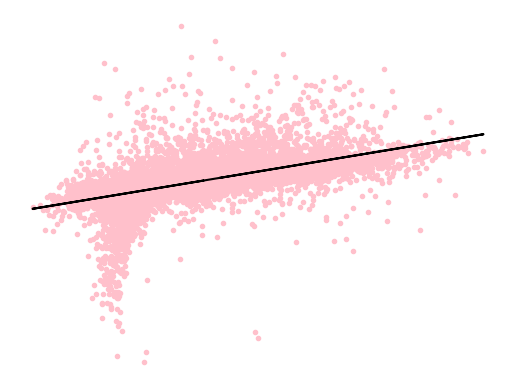

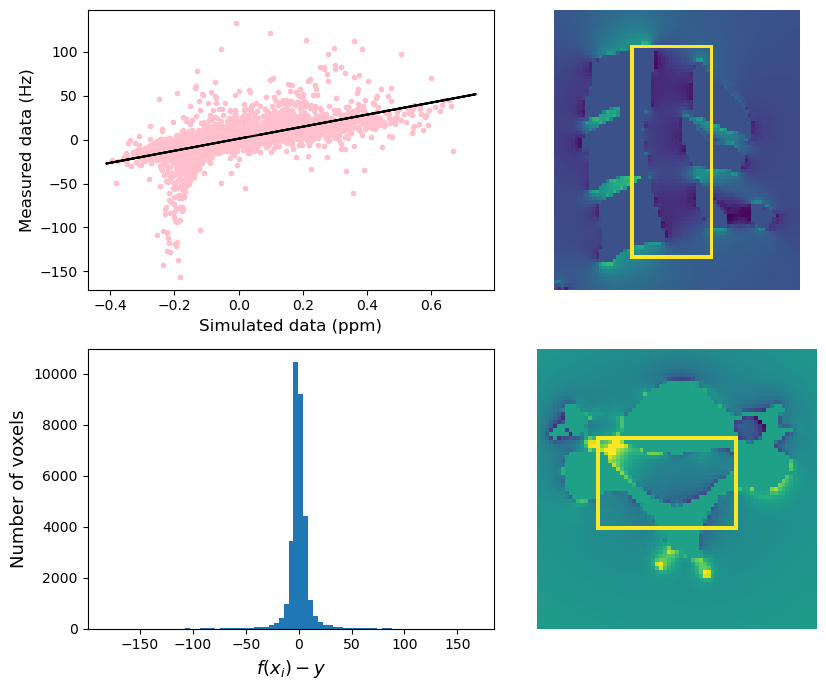

(23, 61, 35)


In [36]:
result_vertebrae_canal_cleaner = linear_reg_simexp_clean(fm_simu1=simu_vertebrae_final, fm_exp1=fm_exp_vertebrae_final_linearcorrection, mask_simu1=simu_mask_vertebrae_final, mask_exp1=mask_vertebrae, part="intervertebral space vertebrae", xmin=9, ymin=22, zmin=15, xmax=70, ymax=45, zmax=50)


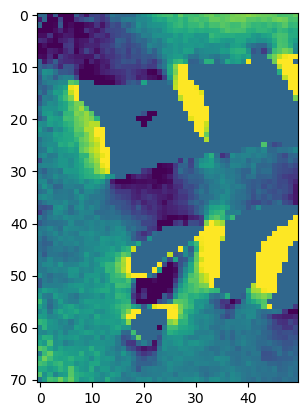

In [37]:
plt.imshow(fm_exp_vertebrae_final_linearcorrection[:,:50,40], vmin=-10, vmax=20)

######## regression linéaire - intervertebral space vertebrae ############
 fm_exp = 52.047526780261464 * fm_simu + 2.2173497304662995 
R^2 = 0.48869813326880207
p-value = 0.0
(-0.4508060246706009, 0.795279923081398)
(-116.10263689920126, 179.5126340761207)


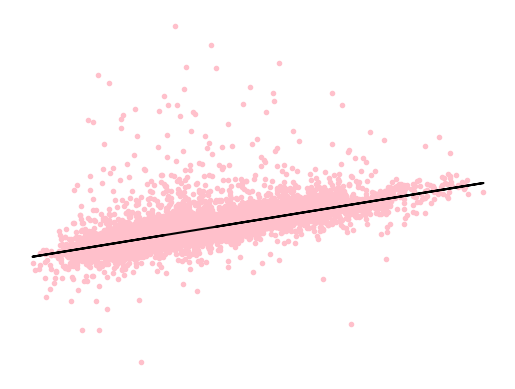

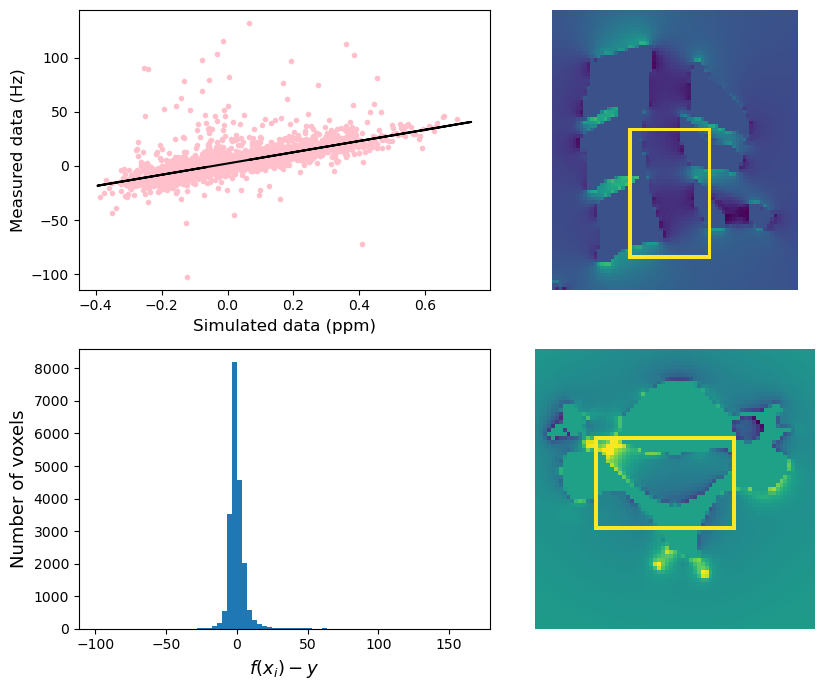

(23, 37, 35)


In [38]:
result_vertebrae_C4C5_cleaner = linear_reg_simexp_clean(fm_simu1=simu_vertebrae_final, fm_exp1=fm_exp_vertebrae_final_linearcorrection, mask_simu1=simu_mask_vertebrae_final, mask_exp1=mask_vertebrae, part="intervertebral space vertebrae", xmin=9, ymin=22, zmin=15, xmax=46, ymax=45, zmax=50)


### Correction of the simulation

In [39]:
# fm_simu_final_vertebrae_corrected = simu_vertebrae_final*result_vertebrae_intervert_linearcorrect.slope
fm_simu_final_vertebrae_corrected = simu_vertebrae_final*result_vertebrae_canal_cleaner.slope

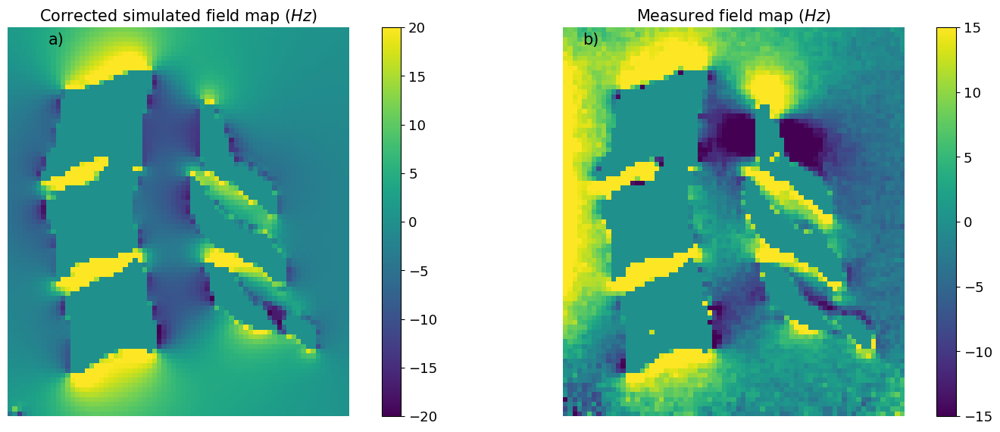

In [40]:
fig=plt.figure(figsize=(14,6))
fig.patch.set_facecolor('white')

slice = dz_vertebrae-3

plt.subplot(1,2,1)
plt.imshow(np.transpose(fm_simu_final_vertebrae_corrected[:,::-1,slice]), vmin=-20, vmax=20)#, aspect='auto')
plt.title('Corrected simulated field map ($Hz$)', size=15)
plt.axis('off')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)

plt.subplot(1,2,2)
plt.imshow(np.transpose(fm_exp_vertebrae_final[:,::-1,slice]), vmin=-15, vmax=15)#, aspect='auto')
plt.title('Measured field map ($Hz$)', size=15)
plt.axis('off')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)


plt.tight_layout()
plt.subplots_adjust(wspace= -0.15, top=0.9, left=-0.15)

#### letters
plt.text(x= -107.5 ,y=3, s='a)', size=15)
plt.text(x= 3.7 ,y=3, s='b)', size=15)

#plt.savefig(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\TORONTO\abstract\images\field_maps.png")
plt.show()
    

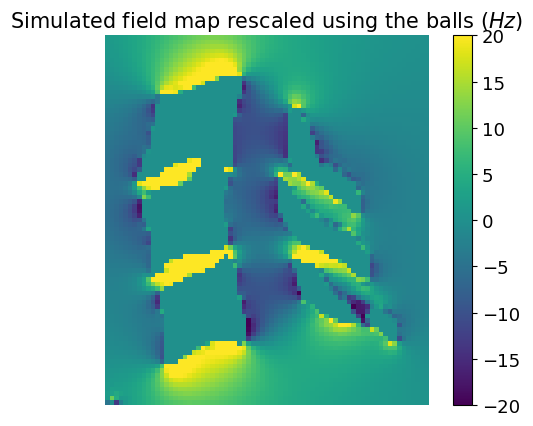

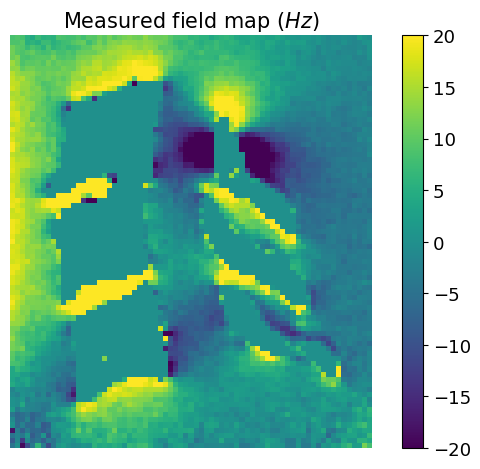

In [41]:
vmin=-20
vmax=20

# fig=plt.figure(figsize=(11,4))
# fig.patch.set_facecolor('white')
ymin, ymax = 0, 75
xmin, xmax = 0, 78

slice = dz_vertebrae-3

# plt.subplot(1,2,1)
plt.figure()
plt.imshow(np.transpose(fm_simu_final_vertebrae_corrected[:,::-1,slice]), vmin=vmin, vmax=vmax) #, aspect='auto')
plt.title('Simulated field map rescaled using the balls ($Hz$)', size=15)
# plt.ylim(ymax,ymin)
plt.axis('off')
# plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
#plt.text(x=83, y=0, s='$\cdot 10^{-2}$', size=13)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\test6_vertebrae\test6_simulated_rescaled_verterbrae_1.tex")

# plt.subplot(1,2,2)
plt.figure()
plt.imshow(np.transpose(fm_exp_vertebrae_final[:,::-1,slice]), vmin=vmin, vmax=vmax)#, aspect='auto')
plt.title('Measured field map ($Hz$)', size=15)
# plt.ylim(ymax,ymin)
plt.axis('off')
# plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\test6_vertebrae\test6_acquired_verterbrae_1.tex")


plt.tight_layout()
# plt.subplots_adjust(wspace= -0.15, top=0.9, left=-0.15)

#### letters
#plt.text(x= -107.5 ,y=3, s='a)', size=15)
#plt.text(x= 3.7 ,y=3, s='b)', size=15)

#plt.savefig(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\TORONTO\abstract\images\field_maps.png")
# plt.show()
#     

In [42]:
def gradient_fm_z_doublemask(fm, mask, material='', plot=True, vmin=-50, vmax=50, vmin_fm=-20, vmax_fm=60):
    '''
    Compute the z-gradient of the FM

    Parameters
    ----------
    fm : numpy.ndarray
        3D array of the field map we want to compute the gradient of.
    mask : numpy.ndarray
        3D array of the mask of the FM.
    material : str, otpional
        description of the compound. The default is ''.
    plot : bool, optional
        if True, plot the z-gradient. The default is True.
    vmin : int, optional
        lower limit of the gradient's color scale. The default is -50.
    vmax : int, optional
        higher limit of the gradient's color scale. The default is 50.
    vmin_fm : int, optional
        lower limit of the FM's color scale. The default is -20.
    vmax_fm : int, optional
        higher limit of the FM's color scale. The default is 60.

    Returns
    -------
    gradient : numpy.ndarray
        z-gradient of the FM.

    '''
    ### correction : we will apply a mask to exclude the vertebrae from both fm and fm_shifted
    mask_shift = np.roll(mask, 1, axis=1)
    maske = mask * mask_shift     
    
    fm_shifted = np.roll(fm, 1, axis=1) # shift from 1 voxel

    # print(np.shape((fm_shifted - fm)))
    gradient = (fm_shifted - fm) * maske
    m,n,p = np.shape(gradient)
    
    if plot==True: 
        plt.figure(figsize=(13,4))
        plt.subplot(1,3,1)
        plt.imshow((fm*mask)[:,:, p//2], vmin=vmin_fm, vmax=vmax_fm)
        plt.colorbar()
        plt.title(f'Field map (Hz) {material}')
        plt.subplot(1,3,2)
        plt.imshow((gradient)[:,1:, p//2], vmin=vmin, vmax=vmax)
        plt.colorbar()
        plt.title(f'Gradient of the fm {material} in the B0 direction')
        plt.subplot(1,3,3)
        plt.imshow(abs(gradient)[:,1:, p//2], vmin=0, vmax=vmax)
        plt.colorbar()
        plt.title(f'absolute gradient of the fm {material} in the B0 direction')
        plt.tight_layout()
    return gradient

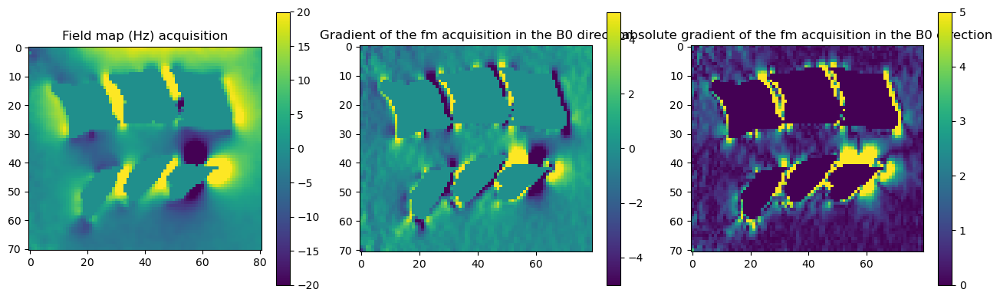

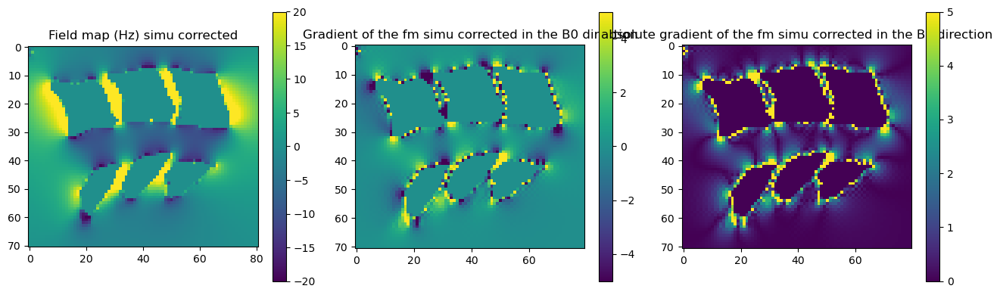

In [44]:
gradient_exp_final = gradient_fm_z_doublemask(gaussian_filter(fm_exp_vertebrae_final, sigma=0.75), mask_vertebrae, material='acquisition', plot=True, vmin=-5, vmax=5, vmin_fm=-20, vmax_fm=20)
gradient_simu_final = gradient_fm_z_doublemask(gaussian_filter(fm_simu_final_vertebrae_corrected, sigma=0), simu_mask_vertebrae_final, material='simu corrected', plot=True, vmin=-5, vmax=5, vmin_fm=-20, vmax_fm=20)


<Figure size 1200x1000 with 0 Axes>

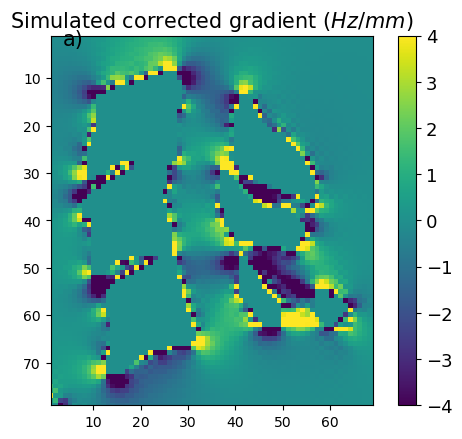

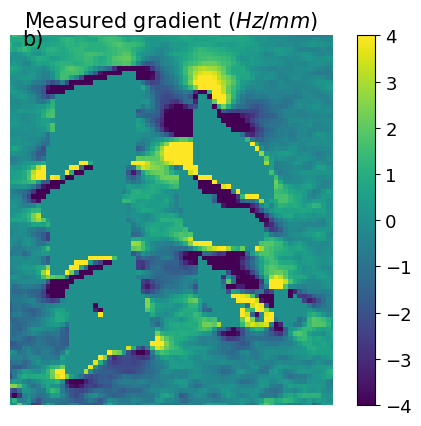

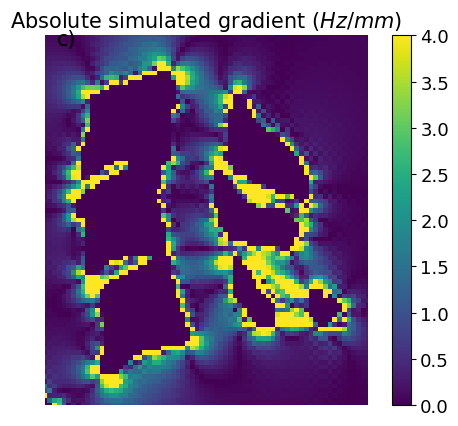

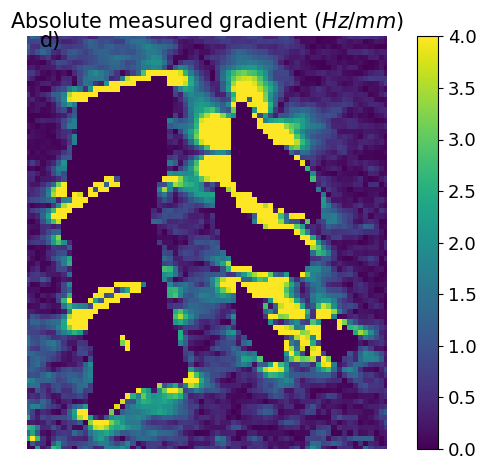

In [46]:
fig=plt.figure(figsize=(12,10))
ymin, ymax = 1, 79
xmin, xmax = 1, 69
fig.patch.set_facecolor('white')

slice = 40

# plt.subplot(2,2,1)
plt.figure()
plt.imshow(np.transpose(gradient_simu_final[:,::-1,slice]), vmin=-4, vmax=4) #, aspect='auto')
plt.title('Simulated corrected gradient ($Hz/mm$)', size=15)
plt.ylim(ymax,ymin)
# plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
plt.text(x= 3.5 ,y=3, s='a)', size=15)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\test6_second_C3C5_gradients\test6_second_C3C5_gradients_1.tex",)


# plt.subplot(2,2,2)
plt.figure()
plt.imshow(np.transpose(gradient_exp_final[:,::-1,slice]), vmin=-4, vmax=4)#, aspect='auto')
plt.title('Measured gradient ($Hz/mm$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
plt.text(x= 3.5 ,y=3, s='b)', size=15)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\test6_second_C3C5_gradients\test6_second_C3C5_gradients_2.tex",)


# plt.subplot(2,2,3)
plt.figure()
plt.imshow(abs(np.transpose(gradient_simu_final[:,::-1,slice])), vmin=-0, vmax=4) #, aspect='auto')
plt.title('Absolute simulated gradient ($Hz/mm$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
plt.text(x= 3.5 ,y=3, s='c)', size=15)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\test6_second_C3C5_gradients\test6_second_C3C5_gradients_3.tex",)


# plt.subplot(2,2,4)
plt.figure()
plt.imshow(abs(np.transpose(gradient_exp_final[:,::-1,slice])), vmin=0, vmax=4)#, aspect='auto')
plt.title('Absolute measured gradient ($Hz/mm$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
plt.text(x= 3.5 ,y=3, s='d)', size=15)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\test6_second_C3C5_gradients\test6_second_C3C5_gradients_4.tex",)



plt.tight_layout()
# plt.savefig(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\TORONTO\abstract\images\gradients.png")

plt.show()

# Multiecho GRE

In [47]:
path_12TE_nylon = [f"JOHANNA_BRUNNHILDE_20230322_144551_837000\GRE_0_3MM_12TE_SPHERE_NYLON_0012\GRE_0_~2_GRE_0.3mm_12TE_sphere_nylon_20230322144552_12_e{i}.nii.gz" for i in range(1,13) ]

(600, 576, 26)


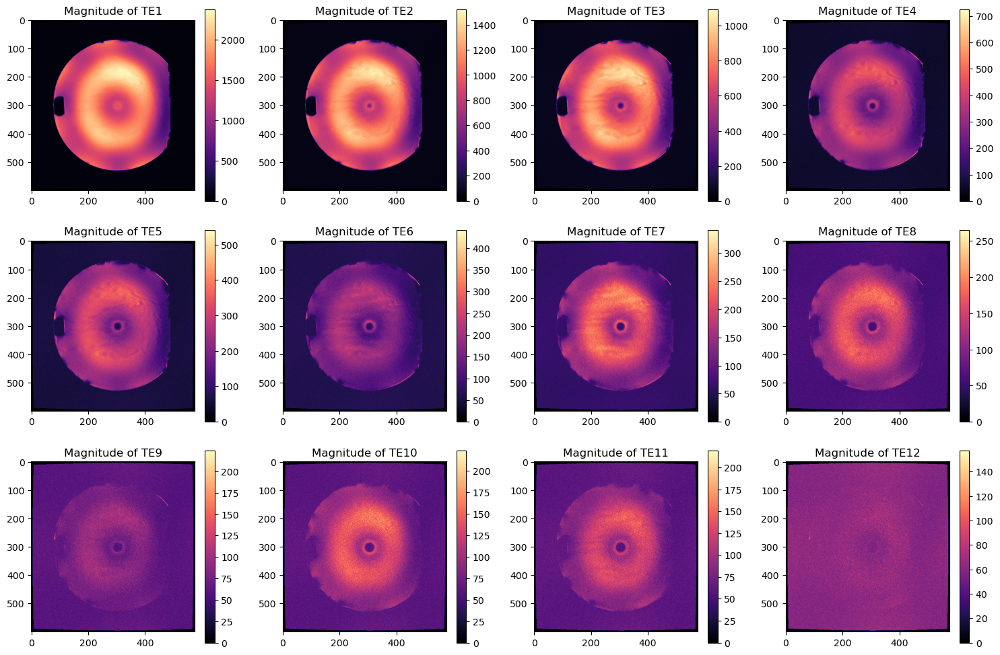

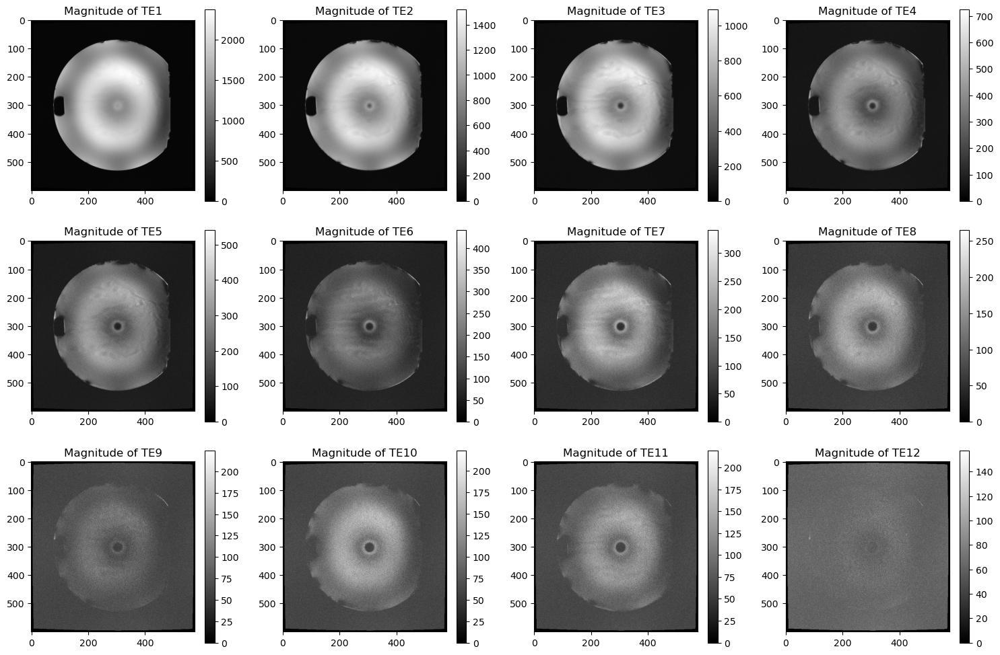

In [48]:
mag_12TE_nylon = [nib.load(path_12TE_nylon[i]).get_fdata() for i in range(12)]

plt.figure('12TE', figsize=(15,10))

for i in range(len(mag_12TE_nylon)):
    plt.subplot(3,4,i+1)
    plt.imshow(mag_12TE_nylon[i][:,:,13] , cmap='magma')
    plt.colorbar()
    plt.title(f'Magnitude of TE{i+1}')

plt.tight_layout()

print(np.shape(mag_12TE_nylon[0]))
plt.show()

plt.figure('12TE', figsize=(15,10))

for i in range(len(mag_12TE_nylon)):
    plt.subplot(3,4,i+1)
    plt.imshow(mag_12TE_nylon[i][:,:,13] , cmap='gray')
    plt.colorbar()
    plt.title(f'Magnitude of TE{i+1}')

plt.tight_layout()

In [49]:
path_12TE_vertebrae = [f"JOHANNA_BRUNNHILDE_20230322_144551_837000\GRE_0_3MM_12TE_VERTEBRAS_0016\GRE_0_~4_GRE_0.3mm_12TE_vertebras_20230322144552_16_e{i}.nii.gz" for i in range(1,13) ]


(600, 576, 26)


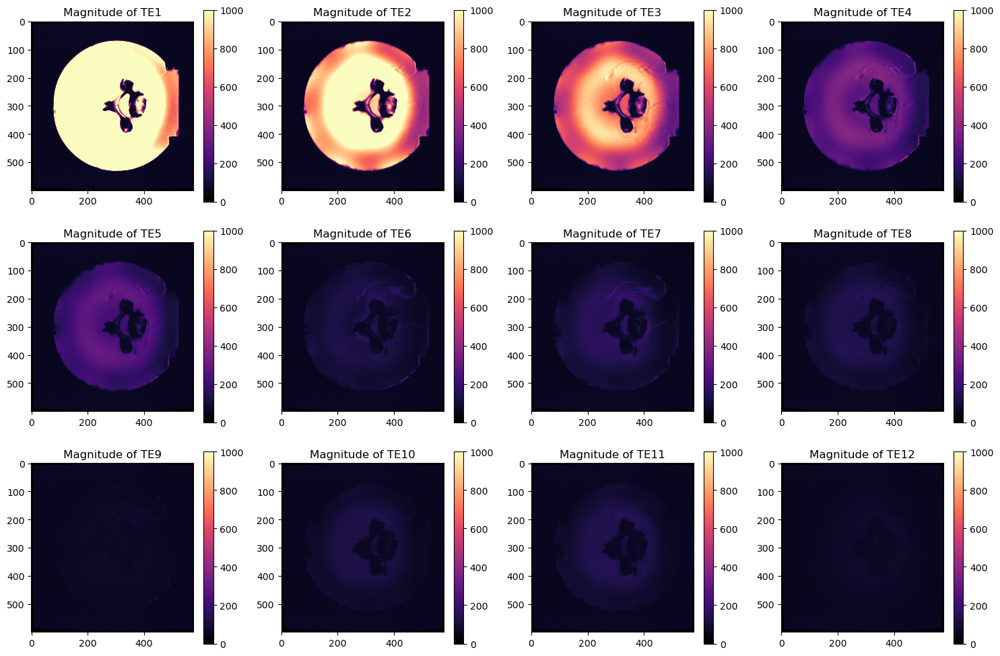

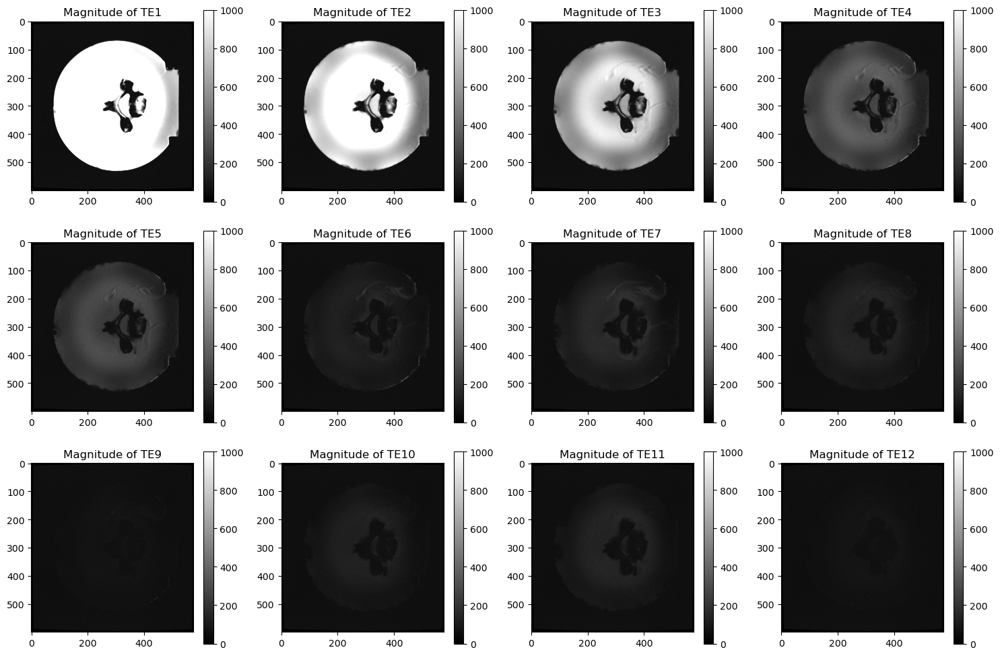

In [50]:
path_12TE_vertebrae = [f"JOHANNA_BRUNNHILDE_20230322_144551_837000\GRE_0_3MM_12TE_VERTEBRAS_0016\GRE_0_~4_GRE_0.3mm_12TE_vertebras_20230322144552_16_e{i}.nii.gz" for i in range(1,13) ]
mag_12TE_vertebrae = [nib.load(path_12TE_vertebrae[i]).get_fdata() for i in range(12)]

plt.figure('12TE', figsize=(15,10))

for i in range(len(mag_12TE_vertebrae)):
    plt.subplot(3,4,i+1)
    plt.imshow(mag_12TE_vertebrae[i][:,:,13] , cmap='magma', vmin=0, vmax=1000)
    plt.colorbar()
    plt.title(f'Magnitude of TE{i+1}')

plt.tight_layout()

print(np.shape(mag_12TE_vertebrae[0]))
plt.show()

plt.figure('12TE', figsize=(15,10))

for i in range(len(mag_12TE_vertebrae)):
    plt.subplot(3,4,i+1)
    plt.imshow(mag_12TE_vertebrae[i][:,:,13] , cmap='gray', vmin=0, vmax=1000)
    plt.colorbar()
    plt.title(f'Magnitude of TE{i+1}')

plt.tight_layout()

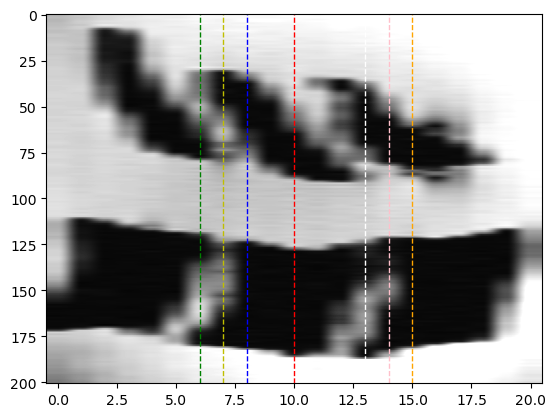

In [51]:
mag_rescaled = rescaling_FOV(mag_12TE_vertebrae[0], x=320, y=300, z=10, dx=100, dy=110, dz=10)
plt.imshow(mag_rescaled[100,:,:] , cmap='gray', vmin=0, vmax=1800, aspect='auto')
#plt.imshow(mag_rescaled[:,:,12] , vmin=0, vmax=1800, aspect='auto')

plt.axvline(x=10,color='r',linestyle='--', linewidth=1)
plt.axvline(x=6,color='g',linestyle='--', linewidth=1)
plt.axvline(x=7,color='y',linestyle='--', linewidth=1)
plt.axvline(x=8,color='b',linestyle='--', linewidth=1)
plt.axvline(x=13,color='w',linestyle='--', linewidth=1)
plt.axvline(x=14,color='pink',linestyle='--', linewidth=1)
plt.axvline(x=15,color='orange',linestyle='--', linewidth=1)
plt.show()

In [52]:
def multiTE_plot(x, mag_multiTE = mag_12TE_vertebrae, color='gray'):
    """
    Plot one transversal slice for the 12 different TE and their difference from the first image.

    Parameters
    ----------
    x : int
        x-coordinate of the slices to display
    mag_multiTE : list, optimal
        list of magnitude 3D arrays for each TE time. The default is mag_12TE.
    color : str, optional
        colormap to use for the images. The default is 'gray'.

    Returns
    -------
    None
        
    """
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(12, 9))
    c=0
    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c], x=320, y=300, z=10, dx=100, dy=110, dz=10)      
        im = ax.imshow(mag_rescaled[:,:,x], cmap=color,vmin=-10, vmax=320)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)
#     plt.savefig('figures/test6_ME_topC5')
    plt.show()
    
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(12, 9))
    c=0
    M1 = rescaling_FOV(mag_multiTE[0], x=320, y=300, z=10, dx=100, dy=110, dz=10)      

    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c],x=320, y=300, z=10, dx=100, dy=110, dz=10)      
        im = ax.imshow((M1[:,:,x]-mag_rescaled[:,:,x]), vmin=10, vmax=1500)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)

    plt.show()

In [54]:
def multiTE_plot_longi(y, mag_multiTE = mag_12TE_vertebrae, color='gray'):
    """
    Plot one longitudinal slice for the 12 different TE and their difference from the first image.

    Parameters
    ----------
    y : int
        y-coordinate of the slices to display
    mag_multiTE : list, optimal
        list of magnitude 3D arrays for each TE time. The default is mag_12TE.
    color : str, optional
        colormap to use for the images. The default is 'gray'.

    Returns
    -------
    None
        
    """
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(15,9))
    c=0
    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c], x=320, y=300, z=10, dx=100, dy=110, dz=10)        
        im = ax.imshow(mag_rescaled[y,:,:], cmap=color, aspect='auto',vmin=-10, vmax=300)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)

    plt.show()
    
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(15,9))
    c=0
    M1=rescaling_FOV(mag_multiTE[0], x=320, y=300, z=10, dx=100, dy=110, dz=10)
    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c], x=320, y=300, z=10, dx=100, dy=110, dz=10)        
        im = ax.imshow(M1[y,:,:]-mag_rescaled[y,:,:],  aspect='auto',vmin=-0, vmax=3000)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)

    plt.show()

############# TE1 to TE12 for a slice in the top C5 (green) ################


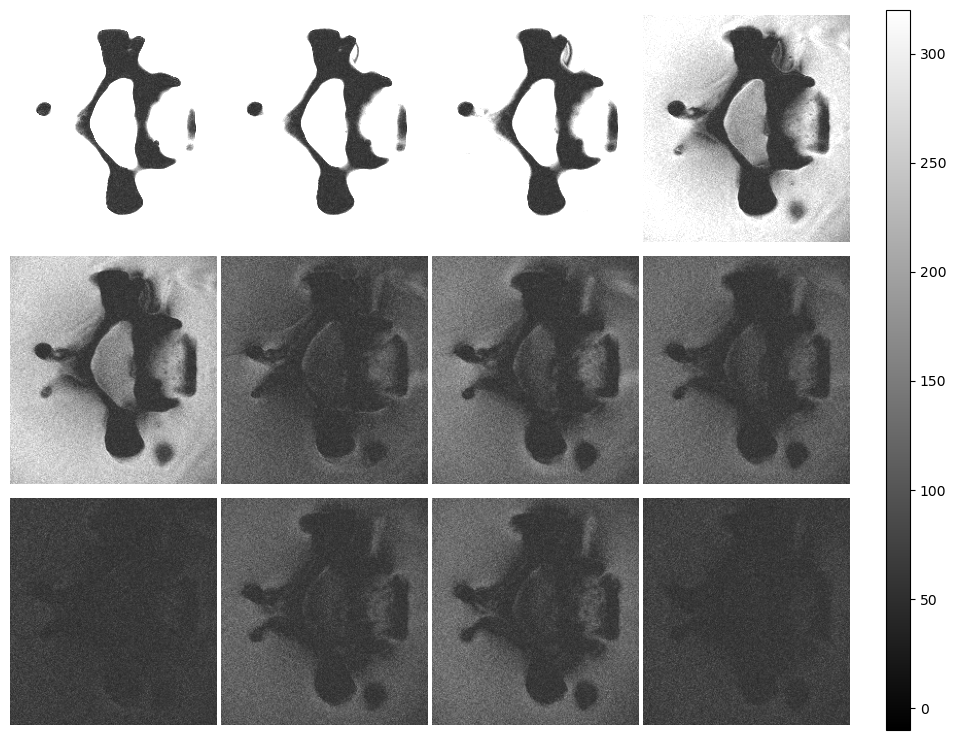

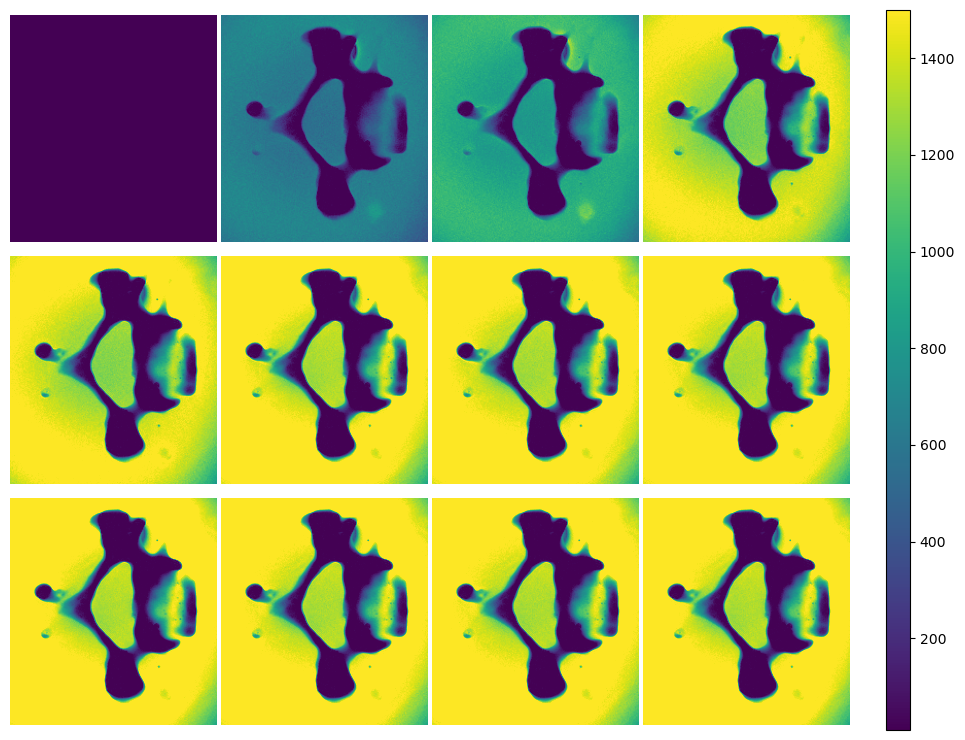

In [55]:
print('############# TE1 to TE12 for a slice in the top C5 (green) ################')
multiTE_plot(6, mag_multiTE = mag_12TE_vertebrae)

############# TE1 to TE12 for a slice between C5 and C4 (yellow) ################


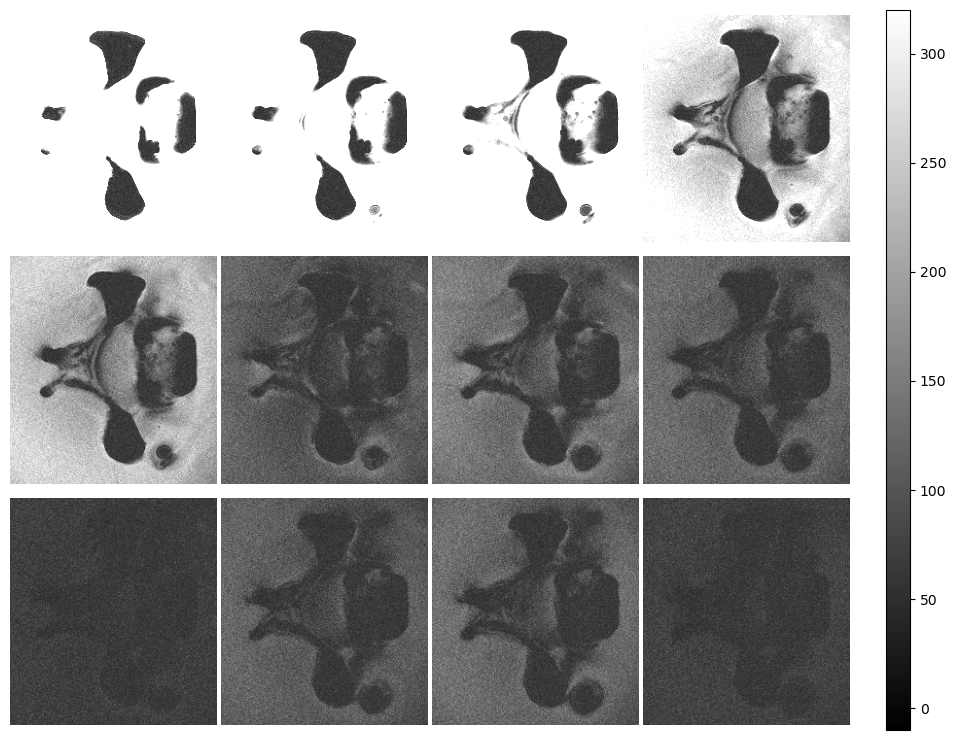

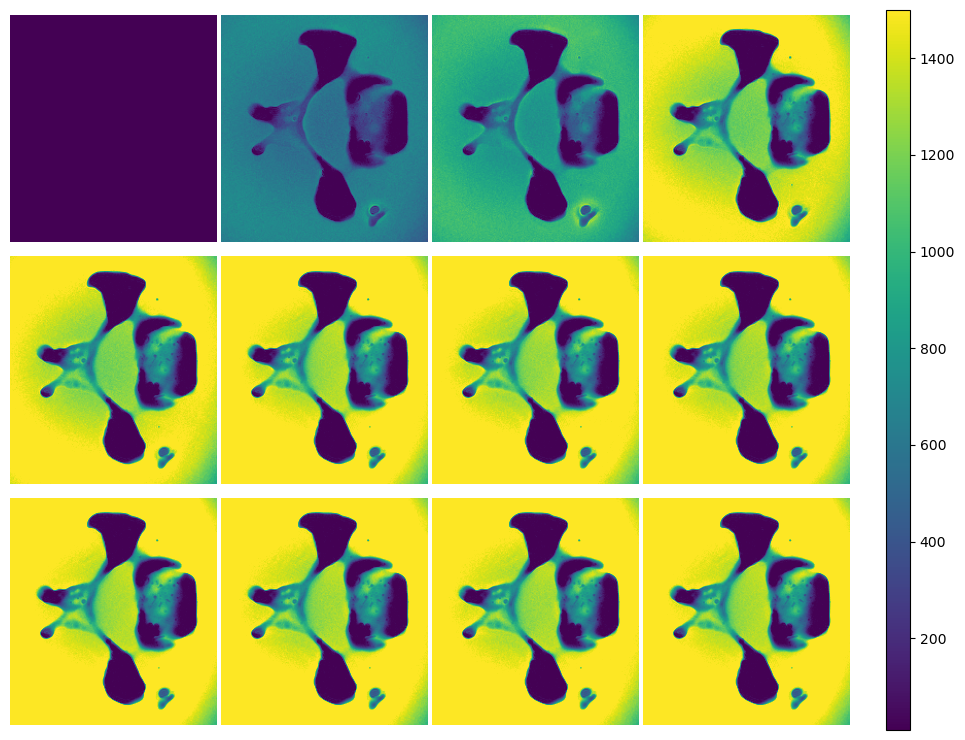

In [56]:
print('############# TE1 to TE12 for a slice between C5 and C4 (yellow) ################')
multiTE_plot(7, mag_multiTE = mag_12TE_vertebrae)

############# TE1 to TE12 for a slice in the bottom of C4 (blue) ################


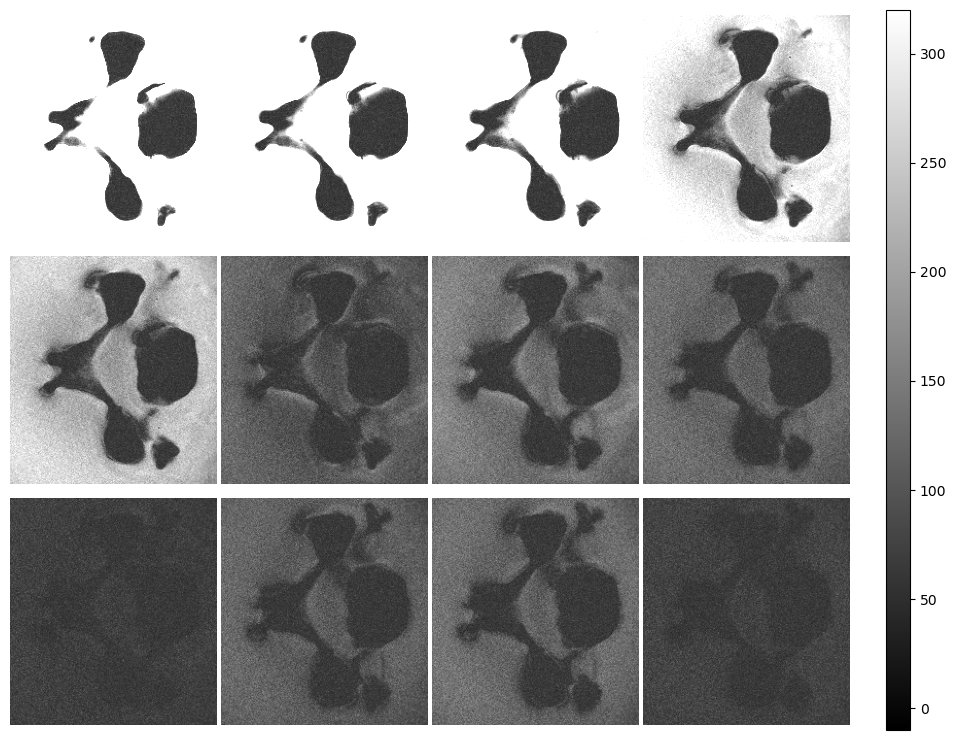

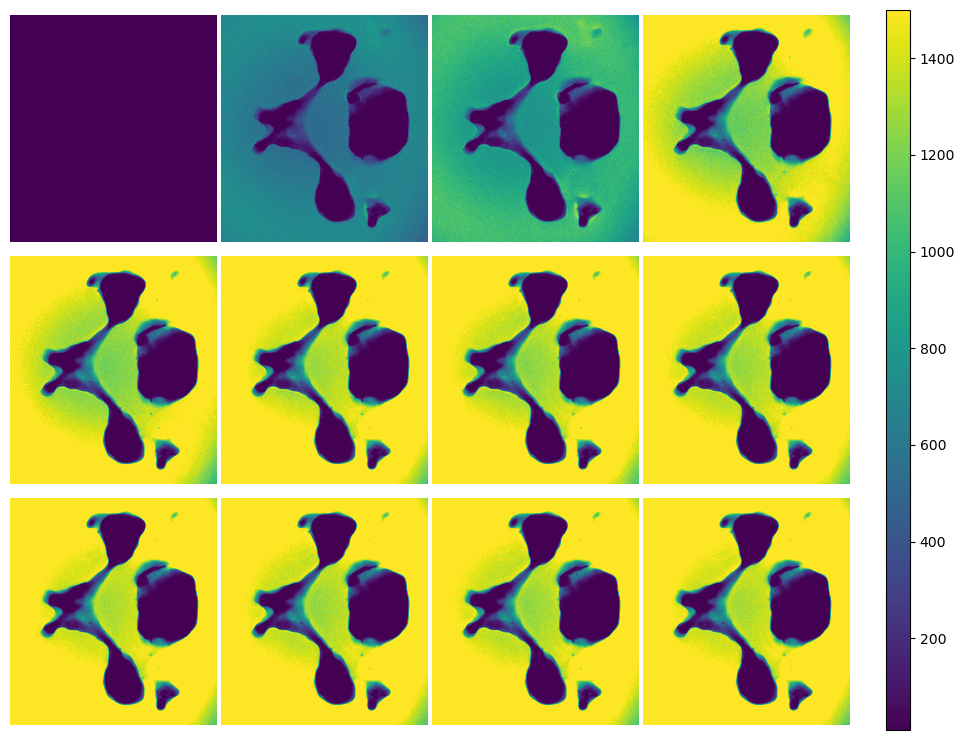

In [57]:
print('############# TE1 to TE12 for a slice in the bottom of C4 (blue) ################')
multiTE_plot(8, mag_multiTE = mag_12TE_vertebrae)

############# TE1 to TE12 for a slice in the middle of C4 (red) ################


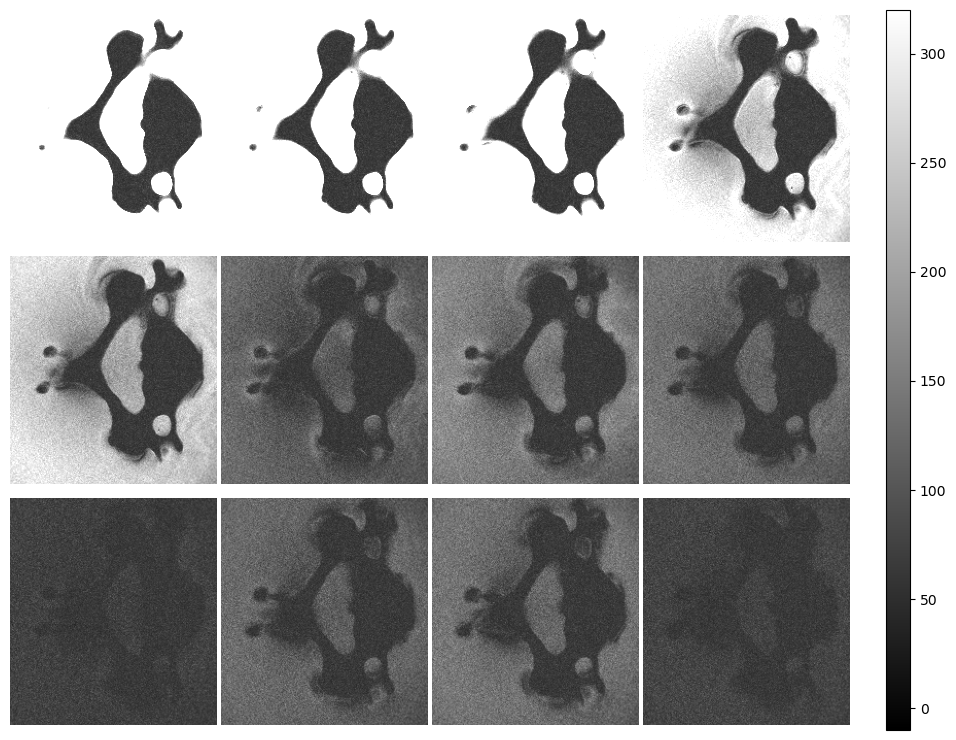

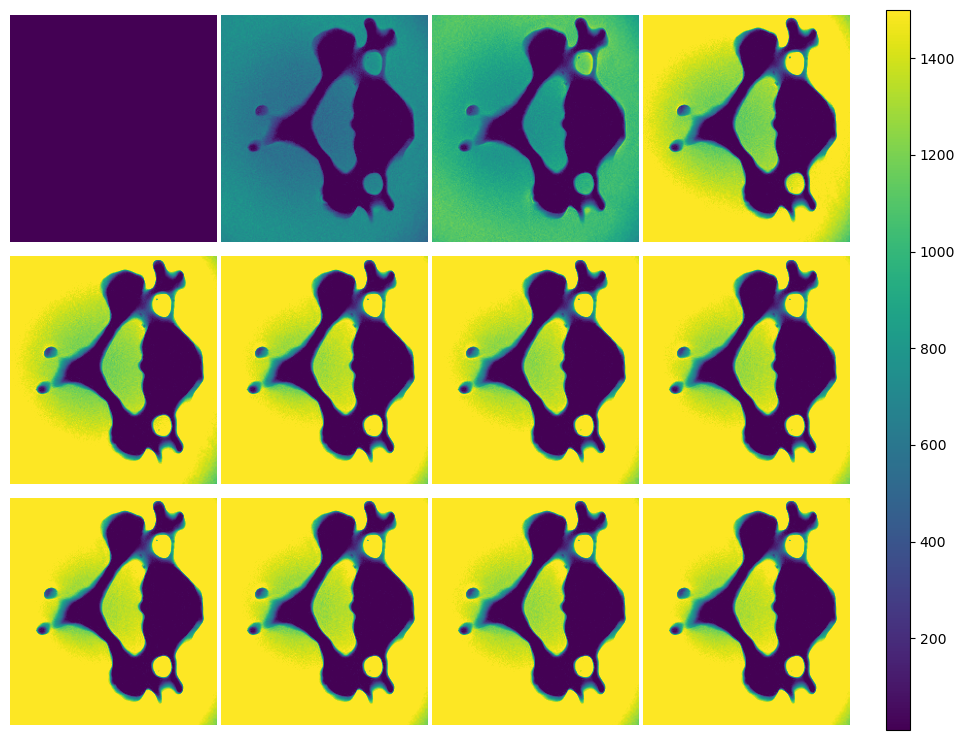

In [58]:
print('############# TE1 to TE12 for a slice in the middle of C4 (red) ################')
multiTE_plot(10, mag_multiTE = mag_12TE_vertebrae)

############# TE1 to TE12 for a slice in the top C4 (white) ################


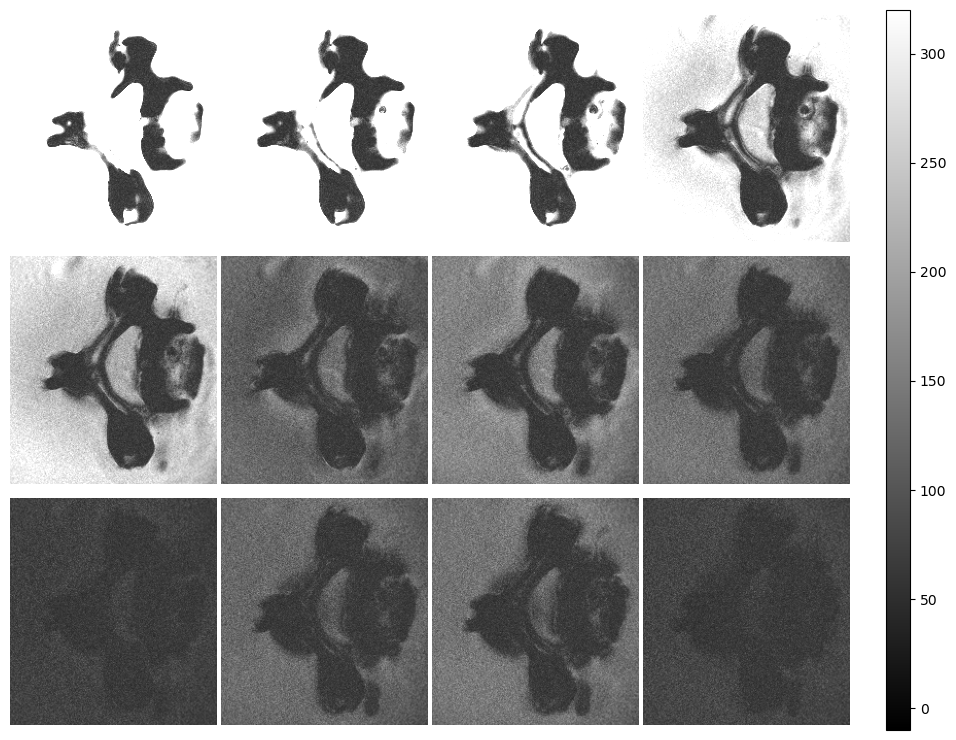

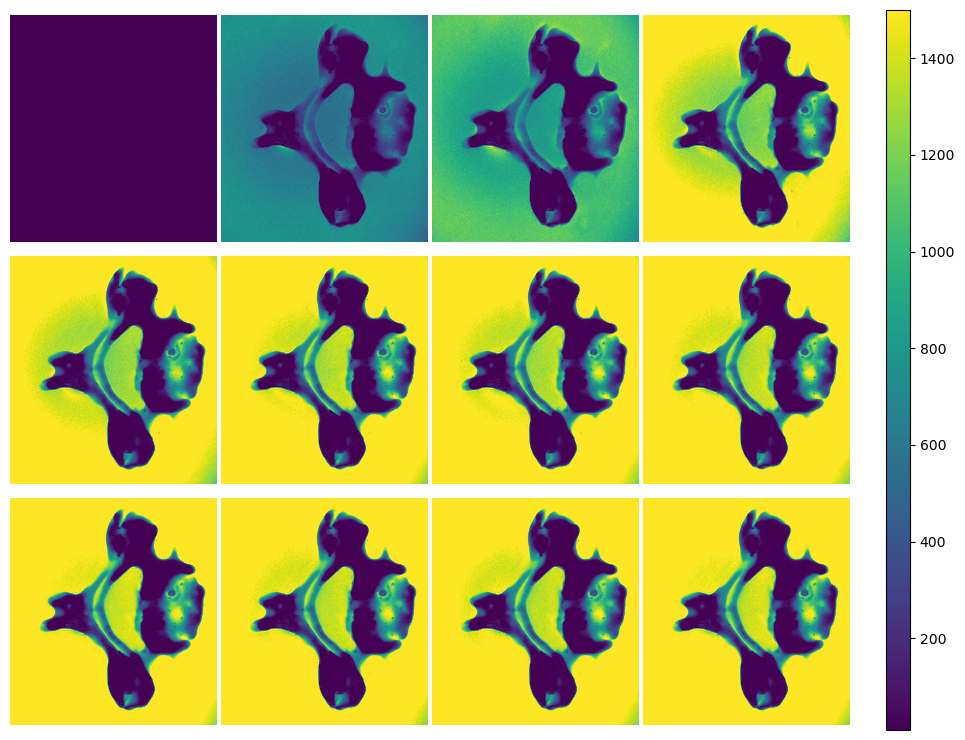

In [59]:
print('############# TE1 to TE12 for a slice in the top C4 (white) ################')
multiTE_plot(13, mag_multiTE = mag_12TE_vertebrae)

############# TE1 to TE12 for a slice between C4 and C3 (pink) ################


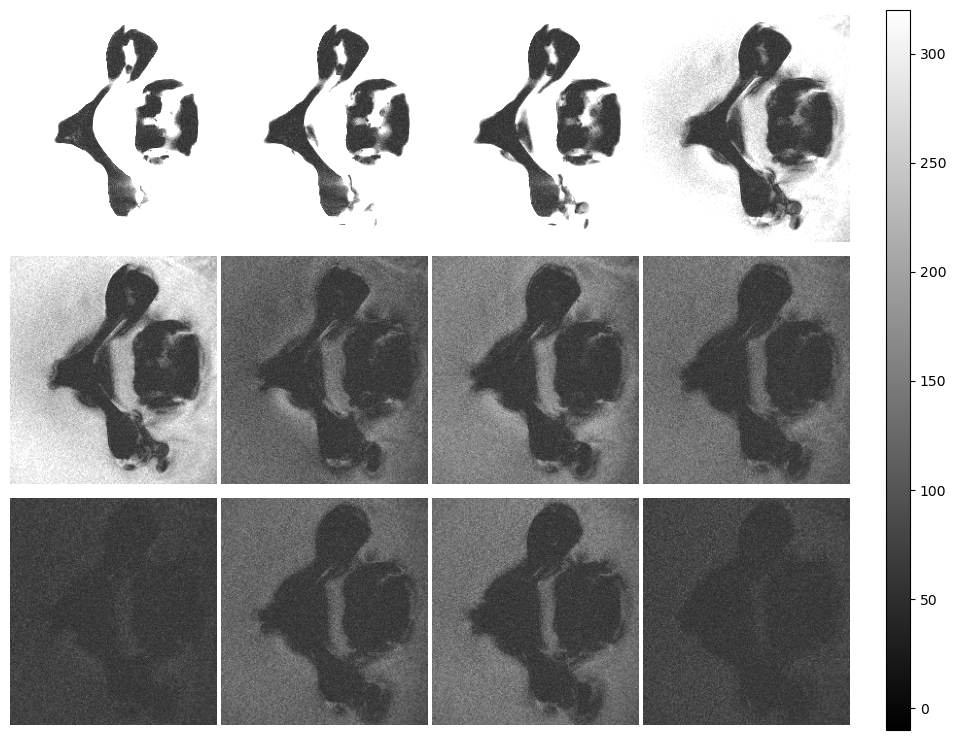

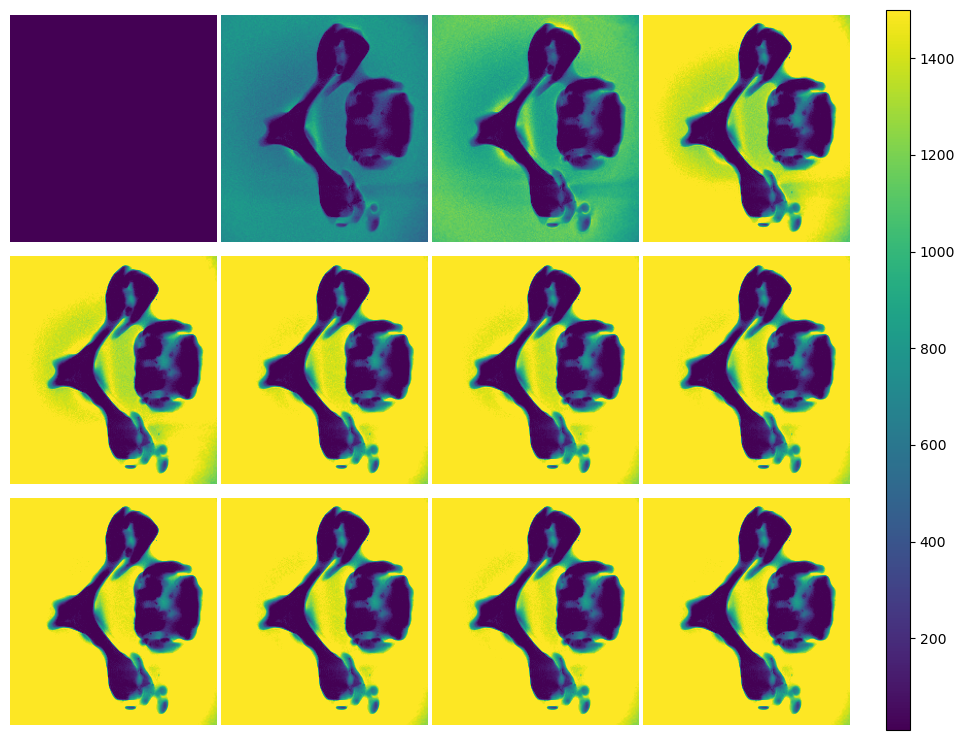

In [60]:
print('############# TE1 to TE12 for a slice between C4 and C3 (pink) ################')
multiTE_plot(14, mag_multiTE = mag_12TE_vertebrae)

############# TE1 to TE12 for a slice in the bottom C3 (orange) ################


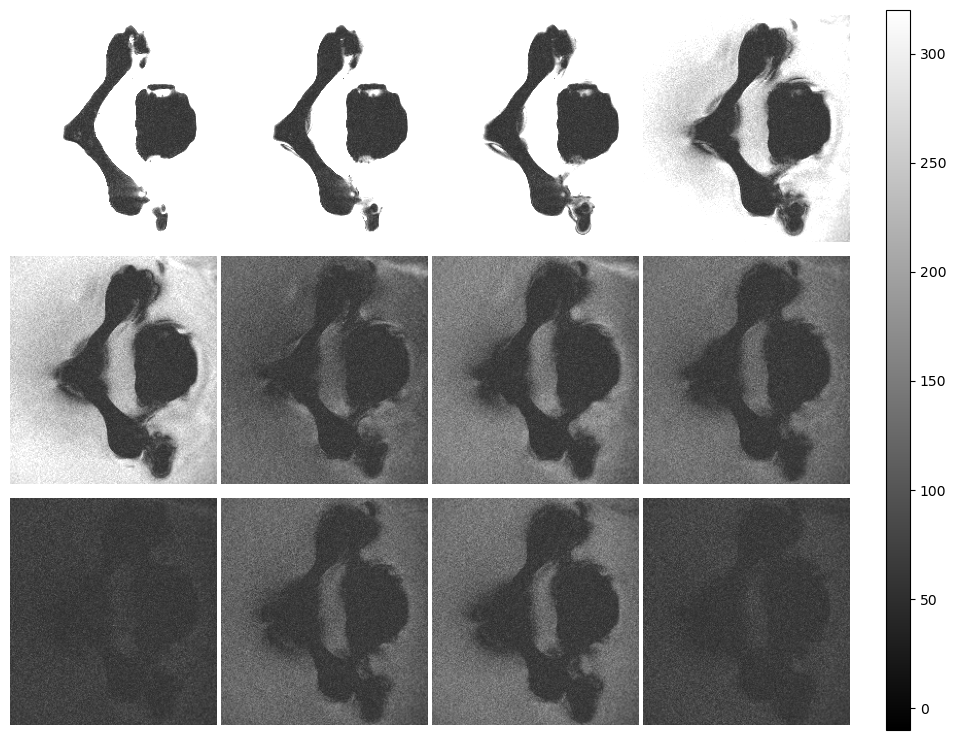

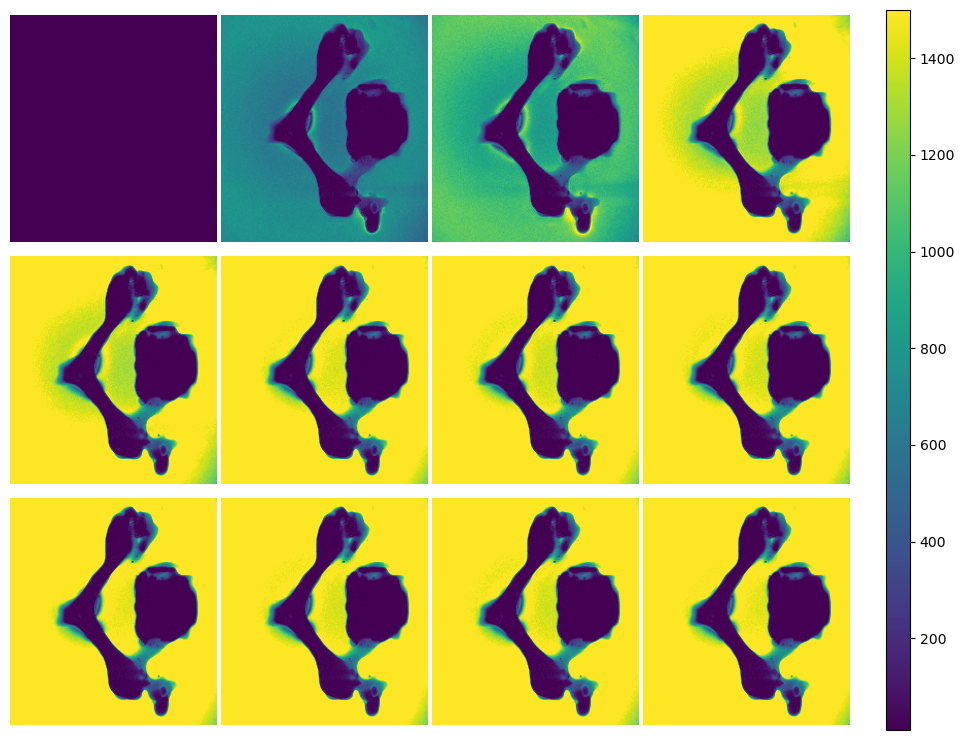

In [61]:
print('############# TE1 to TE12 for a slice in the bottom C3 (orange) ################')
multiTE_plot(15, mag_multiTE = mag_12TE_vertebrae)

############# TE1 to TE12 for longitudinaly ################


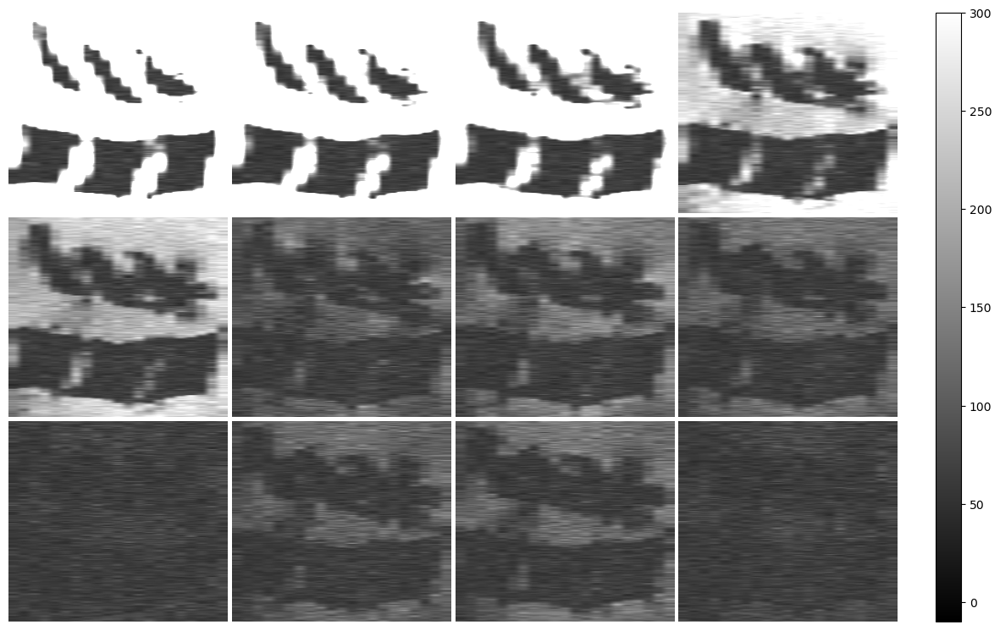

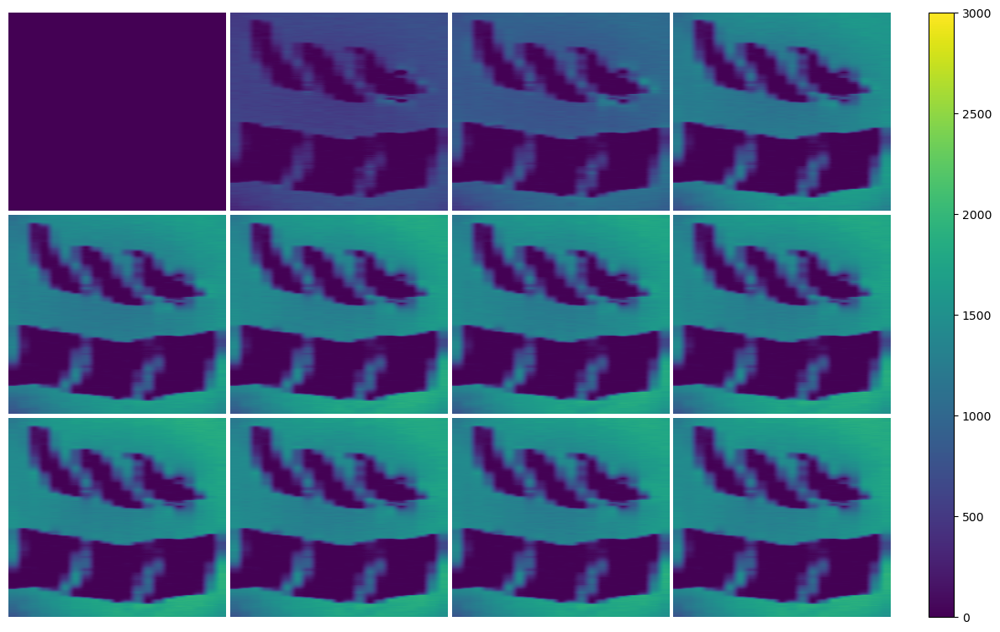

In [62]:
print('############# TE1 to TE12 for longitudinaly ################')
multiTE_plot_longi(100, mag_multiTE = mag_12TE_vertebrae)

# T2 mapping

In [63]:
def T2_calcul(mag_12TE = mag_12TE_vertebrae,y = 180, x=150, z=5, plot_and_print=True):
    '''
    Compute the $T_2^*$ and associated $R^2$ value in one voxel

    Parameters
    ----------
    mag_12TE : numpy.ndarray
        4D array of the magnitudes of the 12 echos.
    y : int, optional
        y coordinate of the voxel. The default is 180.
    x : int, optional
        x coordinate of the voxel. The default is 150.
    z : int, optional
        z coordinate of the voxel. The default is 5.
    plot_and_print : bool, optional
        if True, print the results and plot the selected voxel and the fit. the default is True.
    

    Returns
    -------
    (T2_star, rSquared) : tulle of int
        tulle of the $T_2^*$ and associated $R^2$ of the selected voxel.

    '''
    
    m,n,p = np.shape(mag_12TE[0])
    TE = np.array([7.40, 14, 20.28, 27.20, 33.80, 40.4, 47, 53.6, 60.2, 66.8, 73.4, 80]) #ms
    echo = np.array([mag_12TE[i][y][x][int(z)] for i in range(12)])  #we first try t find the T2 value on one voxel

    def monoExp(t, A, T2_star, b):
        return A * np.exp(-t / T2_star) +b

    # perform the fit
    # p0 = (1, 1) # start with values near those we expect
    params, cv = scipy.optimize.curve_fit(monoExp, TE, echo, bounds=(0, [5000, 500, 500]), maxfev=5000)
    A, T2_star, b = params

    # determine quality of the fit
    squaredDiffs = np.square(echo - monoExp(TE, A, T2_star, b))
    squaredDiffsFromMean = np.square(echo - np.mean(echo))
    rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)


    if plot_and_print == True:
        plt.figure()
        plt.imshow(mag_12TE[0][:,:,int(z)])
        plt.axvline(x=x)
        plt.axhline(y=y)
        plt.colorbar()

        plt.figure()
        plt.plot(TE, echo, "+")
        plt.plot(TE, monoExp(TE, A, T2_star, b), '--', label="fitted")
        plt.title("Fitted Exponential Curve")
        print(f'parameters = {params}')
        print(f"R² = {rSquared}")
    
        # inspect the parameters
        print(f"echo = {A} * e^(-t/{T2_star}) +{b}")
    
    return (T2_star, rSquared)

parameters = [3344.35238403   12.94123817   46.22994907]
R² = 0.9878014371367894
echo = 3344.3523840261873 * e^(-t/12.941238170072316) +46.22994906784857


(12.941238170072316, 0.9878014371367894)

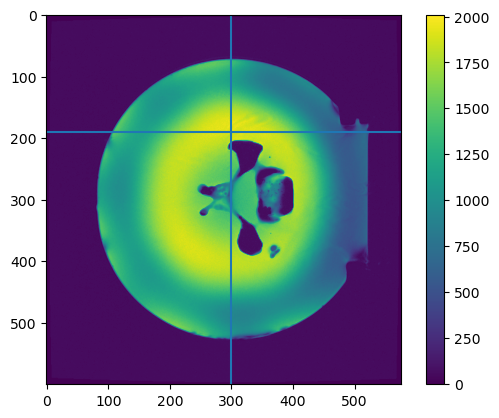

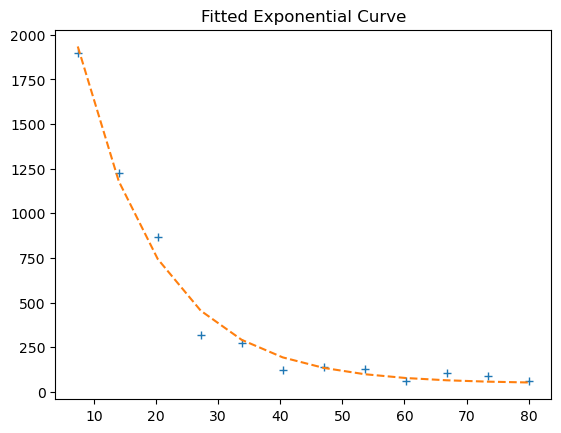

In [64]:
T2_calcul(mag_12TE_vertebrae, x=300, y=190, z= 7)

Note: The following takes ~1 day to run

In [262]:
m,n,p = np.shape(mag_12TE_vertebrae[0])
T2_star_map = np.zeros((m,n,p))
rsquared_map = np.zeros((m,n,p))

for i in tqdm.tqdm(range(m)):
    for j in (range(n)):
        for k in (range(p)):
            if mag_12TE_vertebrae[0][i][j][k] > 750:
                T2_star_map[i][j][k], rsquared_map[i][j][k] = T2_calcul(mag_12TE = mag_12TE_vertebrae,y = i, x=j, z=k, plot_and_print=False)


100%|██████████████████████████████████████████████████████████████████████████████| 600/600 [7:47:17<00:00, 46.73s/it]


(-0.5, 575.5, 599.5, -0.5)

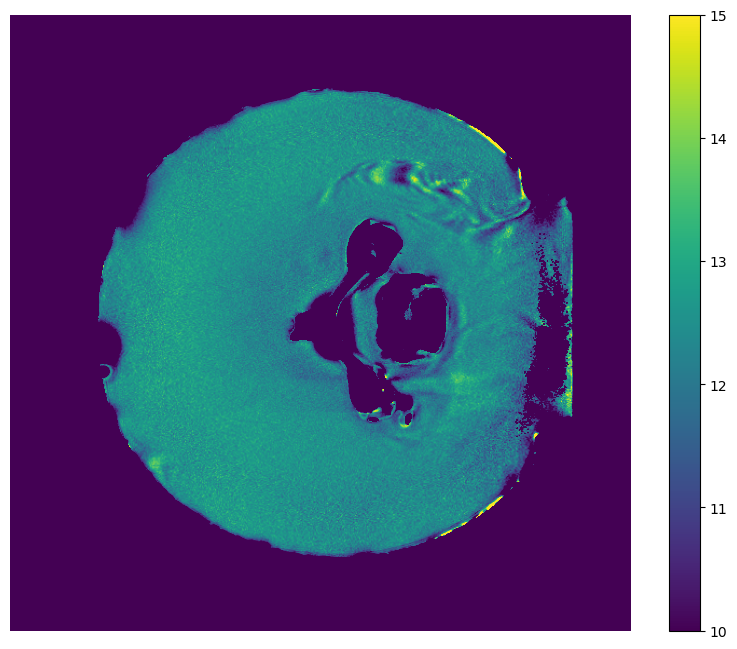

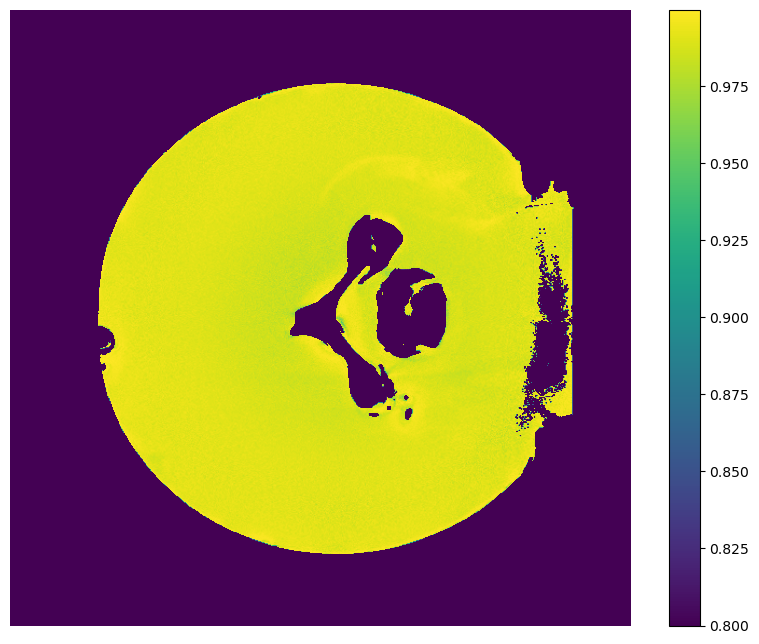

In [278]:
plt.figure(figsize=(10,8))
plt.imshow(T2_star_map[:,:,14], aspect="auto", vmin=10, vmax=15)
plt.colorbar()
plt.axis('off')
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\test6_vertebrae\test6_T2_star_map_1.tex")


plt.figure(figsize=(10,8))
plt.imshow(rsquared_map[:,:,14], aspect="auto", vmin=0.8)
plt.colorbar()
plt.axis('off')
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\test6_vertebrae\test6_T2_star_map_2.tex")

# plt.figure(figsize=(15,5))
# plt.subplot(121)
# plt.imshow(T2_star_map[300,:,:], aspect="auto", vmin=8, vmax=15)
# plt.colorbar()
# plt.subplot(122)
# plt.imshow(rsquared_map[300,:,:], aspect="auto", vmin=0.8)
# plt.colorbar()


Calculation of the averaged $T_2^*$ and the standard deviation

In [287]:
weights = rsquared_map>0.98
# plt.imshow(weights[:,:,13])
avg = np.average(np.array(T2_star_map), weights = weights)
print(f'The average value of the $T_2^*$ is {avg}.')

#TO calculate the standard deviation we cannot use a mask as for the average 
# so we need to extract the values of interet first:
m,n,p=np.shape(rsquared_map)
T2_star_vec=[]
for i in tqdm.tqdm(range(m)):
    for j in (range(n)):
        for k in (range(p)):
            if weights[i][j][k]:
                T2_star_vec.append(T2_star_map[i][j][k])
std = np.std(np.array(T2_star_vec))
avg_ = np.average(np.array(T2_star_vec))

print(f'The standard deviation value of the $T_2^*$ is {std}.')
print(f'The average value (Meth2) of the $T_2^*$ is {avg_}.')
print(f'The number of good values of the map is {len(T2_star_vec)}.')


The average value of the $T_2^*$ is 12.11060634901762.


100%|████████████████████████████████████████████████████████████████████████████████| 600/600 [00:06<00:00, 99.49it/s]


The standard deviation value of the $T_2^*$ is 1.0519632138255453.
The average value (Meth2) of the $T_2^*$ is 12.110606349017631.
The number of good values of the map is 3317273.


number of vowels -->  $R^2$ 

3332387-->  0.8

3331823 --> 0.95

2090048 --> 0.99

3317273  --> 0.98

In [285]:
3331823/3332387*100 #pourcentage of voxels with R^2>0.95


99.98307519504787

In [286]:
2090048/3332387*100 #pourcentage of voxels with R^2>0.99


62.719245993937676

In [288]:
3317273/3332387*100 #pourcentage of voxels with R^2>0.98

99.54645123750633